# Rainfall Weather Forecasting

# Project Description

Weather forecasting is the application of science and technology to predict the conditions of the atmosphere for a given location and time. Weather forecasts are made by collecting quantitative data about the current state of the atmosphere at a given place and using meteorology to project how the atmosphere will change.
Rain Dataset is to predict whether or not it will rain tomorrow. The Dataset contains about 10 years of daily weather observations of different locations in Australia. Here, predict two things:
 
1. Problem Statement: 
a) Design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow.
b)  Design a predictive model with the use of machine learning algorithms to predict how much rainfall could be there.


# TABLE OF CONTENT

1.IMPORTING NECESSARY LIBRARIES
2.LOADING THE DATASET
3.DATA INSPECTION
4.CHECKING FOR NULL AND DUPLICATE VALUES AND REMOVING OR IMPUTATING THEM
5.DATA VISUALIZATION
6.

# IMPORTING NECESSARY LIBRARIES

In [1]:
# Data Analysis & Manipulation
import numpy as np
import pandas as pd

#Data visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Outlier Treatment, Peprocessor, Scaler
from scipy.stats import zscore
from sklearn.preprocessing import LabelEncoder, StandardScaler, PowerTransformer
from statsmodels.stats.outliers_influence import variance_inflation_factor
from imblearn.over_sampling import SMOTE

#Classifiers
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import RidgeClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from xgboost import XGBClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier

# Regressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import Lasso,Ridge, LinearRegression, SGDRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, BaggingRegressor, AdaBoostRegressor
from xgboost import XGBRegressor

#Evaluation & Metrics
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

#Saving Model
import joblib

# Prevent WARNINGS!
import warnings
warnings.filterwarnings('ignore')


# LOADING THE DATASET

In [2]:
# Loading Dataset
df = pd.read_csv("https://raw.githubusercontent.com/dsrscientist/dataset3/main/weatherAUS.csv")
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


# DATA INSPECTION

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   MinTemp        8350 non-null   float64
 3   MaxTemp        8365 non-null   float64
 4   Rainfall       8185 non-null   float64
 5   Evaporation    4913 non-null   float64
 6   Sunshine       4431 non-null   float64
 7   WindGustDir    7434 non-null   object 
 8   WindGustSpeed  7434 non-null   float64
 9   WindDir9am     7596 non-null   object 
 10  WindDir3pm     8117 non-null   object 
 11  WindSpeed9am   8349 non-null   float64
 12  WindSpeed3pm   8318 non-null   float64
 13  Humidity9am    8366 non-null   float64
 14  Humidity3pm    8323 non-null   float64
 15  Pressure9am    7116 non-null   float64
 16  Pressure3pm    7113 non-null   float64
 17  Cloud9am       6004 non-null   float64
 18  Cloud3pm

In [4]:
df.tail()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No
8424,2017-06-25,Uluru,14.9,NaN,0.0,NaN,NaN,NaN,NaN,ESE,...,62.0,36.0,1020.2,1017.9,8.0,8.0,15.0,20.9,No,NaN


In [5]:
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [6]:
df.shape

(8425, 23)

In [7]:
df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

In [8]:
df.dtypes

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

In [9]:
df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,8350.000000,8365.000000,8185.000000,4913.000000,4431.000000,7434.000000,8349.000000,8318.000000,8366.000000,8323.000000,7116.000000,7113.000000,6004.000000,5970.000000,8369.000000,8329.000000
mean,13.193305,23.859976,2.805913,5.389395,7.632205,40.174469,13.847646,18.533662,67.822496,51.249790,1017.640233,1015.236075,4.566622,4.503183,17.762015,22.442934
std,5.403596,6.136408,10.459379,5.044484,3.896235,14.665721,10.174579,9.766986,16.833283,18.423774,6.828699,6.766681,2.877658,2.731659,5.627035,5.980020
min,-2.000000,8.200000,0.000000,0.000000,0.000000,7.000000,0.000000,0.000000,10.000000,6.000000,989.800000,982.900000,0.000000,0.000000,1.900000,7.300000
25%,9.200000,19.300000,0.000000,2.600000,4.750000,30.000000,6.000000,11.000000,56.000000,39.000000,1013.000000,1010.400000,1.000000,2.000000,13.800000,18.000000
50%,13.300000,23.300000,0.000000,4.600000,8.700000,39.000000,13.000000,19.000000,68.000000,51.000000,1017.700000,1015.300000,5.000000,5.000000,17.800000,21.900000
75%,17.400000,28.000000,1.000000,7.000000,10.700000,50.000000,20.000000,24.000000,80.000000,63.000000,1022.300000,1019.800000,7.000000,7.000000,21.900000,26.400000
max,28.500000,45.500000,371.000000,145.000000,13.900000,107.000000,63.000000,83.000000,100.000000,99.000000,1039.000000,1036.000000,8.000000,8.000000,39.400000,44.100000


In [10]:
df.nunique()

Date             3004
Location           12
MinTemp           285
MaxTemp           331
Rainfall          250
Evaporation       116
Sunshine          140
WindGustDir        16
WindGustSpeed      52
WindDir9am         16
WindDir3pm         16
WindSpeed9am       34
WindSpeed3pm       35
Humidity9am        90
Humidity3pm        94
Pressure9am       384
Pressure3pm       374
Cloud9am            9
Cloud3pm            9
Temp9am           304
Temp3pm           328
RainToday           2
RainTomorrow        2
dtype: int64

In [11]:
for col in df.columns:
    frequencies = df[col].value_counts()
    print(f"Unique values in column {col}:")
    print(frequencies)
    print("\n")

Unique values in column Date:
2011-01-31    5
2011-05-08    5
2011-05-21    5
2011-05-20    5
2011-05-19    5
             ..
2013-01-28    1
2013-01-29    1
2013-01-30    1
2013-01-31    1
2013-06-08    1
Name: Date, Length: 3004, dtype: int64


Unique values in column Location:
Melbourne       1622
Williamtown     1230
PerthAirport    1204
Albury           907
Newcastle        822
CoffsHarbour     611
Brisbane         579
Penrith          482
Wollongong       474
Darwin           250
Adelaide         205
Uluru             39
Name: Location, dtype: int64


Unique values in column MinTemp:
 12.0    74
 13.2    71
 13.8    69
 12.7    68
 16.4    67
         ..
 0.3      1
 28.3     1
-1.1      1
-1.4      1
 26.0     1
Name: MinTemp, Length: 285, dtype: int64


Unique values in column MaxTemp:
19.0    87
23.8    75
19.8    74
25.0    71
22.0    68
        ..
11.2     1
43.1     1
42.7     1
42.9     1
43.5     1
Name: MaxTemp, Length: 331, dtype: int64


Unique values in column Rainfal

# CHECKING FOR NULL AND DUPLICATE VALUES AND REMOVING OR IMPUTATING THEM

In [12]:
df.duplicated().sum()

1663

In [13]:
df.drop_duplicates(keep='last', inplace=True)

In [14]:
df.duplicated().sum()

0

In [15]:
df.isnull().sum()

Date                0
Location            0
MinTemp            70
MaxTemp            57
Rainfall          138
Evaporation      2921
Sunshine         3236
WindGustDir       942
WindGustSpeed     942
WindDir9am        794
WindDir3pm        294
WindSpeed9am       63
WindSpeed3pm      100
Humidity9am        54
Humidity3pm        96
Pressure9am      1308
Pressure3pm      1311
Cloud9am         1866
Cloud3pm         1902
Temp9am            51
Temp3pm            92
RainToday         138
RainTomorrow      138
dtype: int64

In [16]:
# Separating Numerical & Categorical columns from the entire dataset
categorical_columns = df.select_dtypes(include=['object']).columns
numerical_columns = df.select_dtypes(include=['float64']).columns
print('Separating Numerical & Categorical columns from the entire dataset:','\n')
print('Categorical columns are: ',categorical_columns)
print('\n')
print('Numerical_columns are: ',numerical_columns)

Separating Numerical & Categorical columns from the entire dataset: 

Categorical columns are:  Index(['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm',
       'RainToday', 'RainTomorrow'],
      dtype='object')


Numerical_columns are:  Index(['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm'],
      dtype='object')


In [17]:
df[categorical_columns].isnull().sum()

Date              0
Location          0
WindGustDir     942
WindDir9am      794
WindDir3pm      294
RainToday       138
RainTomorrow    138
dtype: int64

In [18]:
df[numerical_columns].isnull().sum()

MinTemp            70
MaxTemp            57
Rainfall          138
Evaporation      2921
Sunshine         3236
WindGustSpeed     942
WindSpeed9am       63
WindSpeed3pm      100
Humidity9am        54
Humidity3pm        96
Pressure9am      1308
Pressure3pm      1311
Cloud9am         1866
Cloud3pm         1902
Temp9am            51
Temp3pm            92
dtype: int64

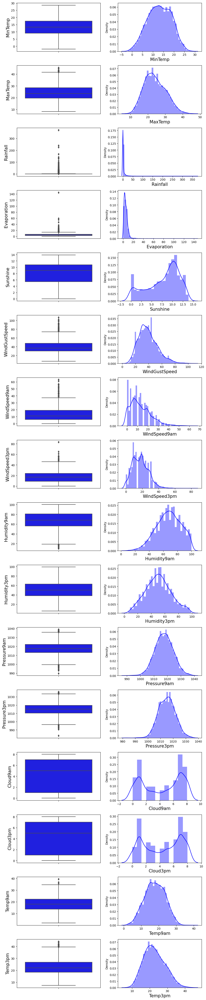

In [19]:
# Visualizing Numerical columns befor missing value imputation
plt.figure(figsize=(10, 3 * len(numerical_columns)))

# Loop through each numerical column and create plots
for i, column in enumerate(numerical_columns):
    plt.subplot(len(numerical_columns), 2, 2 * i + 1)
    sns.boxplot(y=column, data=df, color='blue')
    plt.ylabel(column, fontsize=15)
    
    plt.subplot(len(numerical_columns), 2, 2 * i + 2)
    sns.distplot(df[column], color='blue')
    plt.xlabel(column, fontsize=15)

plt.tight_layout()
plt.show()

In [20]:
# Imputation techniques
impute_techniques = {
    'MinTemp': 'mean',
    'MaxTemp': 'median',
    'Rainfall': 'median',
    'Evaporation': 'median',
    'Sunshine': 'mean',
    'WindGustSpeed': 'median',
    'WindSpeed9am': 'median',
    'WindSpeed3pm':'median',
    'Humidity9am': 'median',
    'Humidity3pm': 'mean',
    'Pressure9am': 'median',
    'Pressure3pm': 'median',
    'Cloud9am': 'mean',
    'Cloud3pm': 'mean',
    'Temp9am': 'median',
    'Temp3pm': 'median',
    'WindGustDir' : 'mode',
    'WindDir9am' : 'mode',
    'WindDir3pm' : 'mode',
    'RainToday' : 'mode',
    'RainTomorrow' : 'mode'   
}

# Impute based on defined techniques
for column, technique in impute_techniques.items():
    if technique == 'mode':
        mode_value = df[column].mode()[0]
        df[column].fillna(mode_value, inplace=True)
    elif technique == 'mean':
        mean_value = df[column].mean()
        df[column].fillna(mean_value, inplace=True)
    elif technique == 'median':
        median_value = df[column].median()
        df[column].fillna(median_value, inplace=True)

df.sample(5)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
2310,2015-08-10,Newcastle,7.4,20.0,0.0,4.6,7.890896,E,37.0,NW,...,68.0,50.467147,1017.6,1015.1,1.0,4.320988,11.5,22.1,No,No
797,2011-02-06,Albury,14.7,21.5,51.0,4.6,7.890896,WSW,43.0,WNW,...,81.0,45.000000,1017.0,1019.6,8.0,4.320988,14.7,19.1,Yes,No
7725,2013-04-28,PerthAirport,11.6,24.8,0.0,2.6,9.900000,SW,31.0,S,...,70.0,35.000000,1020.1,1017.8,3.0,1.000000,19.3,24.2,No,No
6345,2011-09-03,Brisbane,11.8,22.1,0.0,5.6,9.200000,SE,30.0,SSW,...,58.0,40.000000,1029.2,1026.0,3.0,6.000000,18.3,21.4,No,No
1440,2010-08-25,CoffsHarbour,8.6,19.7,0.0,1.0,3.900000,W,30.0,NW,...,60.0,54.000000,1010.1,1006.9,3.0,8.000000,14.6,18.4,No,No


In [21]:
df.isnull().sum()

Date             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

In [22]:
# Converting Date column datatype and spliting Date column into Day, Month and Year column having values from the original Date.
df['Date']=pd.to_datetime(df['Date'])
df['Day']=df['Date'].apply(lambda x:x.day)
df['Month']=df['Date'].apply(lambda x:x.month)
df['Year']=df['Date'].apply(lambda x:x.year)
# Dropping date column from both the date set and categorical column
df.drop('Date', axis=1, inplace = True)
categorical_columns=categorical_columns.drop('Date')

In [23]:
#checking dataframe
df.columns

Index(['Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow', 'Day', 'Month', 'Year'],
      dtype='object')

In [24]:
#checking dataframe
categorical_columns

Index(['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday',
       'RainTomorrow'],
      dtype='object')

In [25]:
# Calculate value counts for our target
value_counts = df.RainTomorrow.value_counts()

# Calculate percentages
percentages = (value_counts / len(df)) * 100

# Combine value counts and percentages into a DataFrame
Rainfall = pd.DataFrame({'Count': value_counts, 'Percentage': percentages})

# Print the result DataFrame
print(Rainfall)

     Count  Percentage
No    5190    76.75244
Yes   1572    23.24756


THE ABOVE SHOWS THE REPRESENTATION OF PERCENTAGES OF RAINING THAT HAS BEEN PROVIDED IN THE DATA AS RAINTOMMOROW COLUMN

In [26]:
for col in numerical_columns:
    print(f"Minimum Capacity of {col}:", df[col].min())
    print(f"Maximum Capacity of {col}:", df[col].max())
    print('='*50)

Minimum Capacity of MinTemp: -2.0
Maximum Capacity of MinTemp: 28.5
Minimum Capacity of MaxTemp: 8.2
Maximum Capacity of MaxTemp: 45.5
Minimum Capacity of Rainfall: 0.0
Maximum Capacity of Rainfall: 371.0
Minimum Capacity of Evaporation: 0.0
Maximum Capacity of Evaporation: 145.0
Minimum Capacity of Sunshine: 0.0
Maximum Capacity of Sunshine: 13.9
Minimum Capacity of WindGustSpeed: 7.0
Maximum Capacity of WindGustSpeed: 107.0
Minimum Capacity of WindSpeed9am: 0.0
Maximum Capacity of WindSpeed9am: 63.0
Minimum Capacity of WindSpeed3pm: 0.0
Maximum Capacity of WindSpeed3pm: 83.0
Minimum Capacity of Humidity9am: 10.0
Maximum Capacity of Humidity9am: 100.0
Minimum Capacity of Humidity3pm: 6.0
Maximum Capacity of Humidity3pm: 99.0
Minimum Capacity of Pressure9am: 989.8
Maximum Capacity of Pressure9am: 1039.0
Minimum Capacity of Pressure3pm: 982.9
Maximum Capacity of Pressure3pm: 1036.0
Minimum Capacity of Cloud9am: 0.0
Maximum Capacity of Cloud9am: 8.0
Minimum Capacity of Cloud3pm: 0.0
Maxi

In [27]:
df.Rainfall.value_counts()

0.0      4472
0.2       321
0.4       144
0.6        87
1.2        69
         ... 
73.8        1
23.8        1
61.2        1
128.0       1
40.0        1
Name: Rainfall, Length: 250, dtype: int64

# DATA VISUALIZATION

# UNIVARIATE ANALYSIS THROUGH DATA VISUALIZATION

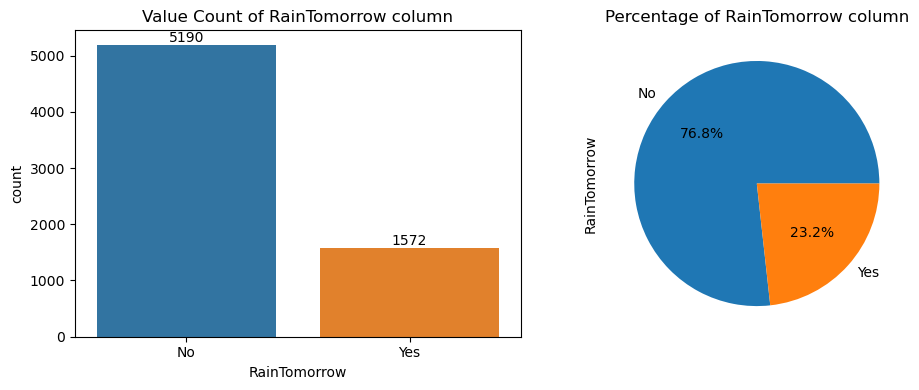

In [28]:
# Visualizing it:
fig, axes = plt.subplots(1,2,figsize=(10,4))

# First plot: Value count of the column using count plot
ax = sns.countplot(x='RainTomorrow', data=df, ax=axes[0])
for container in ax.containers:
    ax.bar_label(container)
axes[0].set_title('Value Count of RainTomorrow column')

# Second plot: Percentage of RainTomorrow column
df['RainTomorrow'].value_counts().plot(kind="pie", autopct="%0.1f%%", ax=axes[1])
axes[1].set_title('Percentage of RainTomorrow column')

plt.tight_layout()
plt.show()

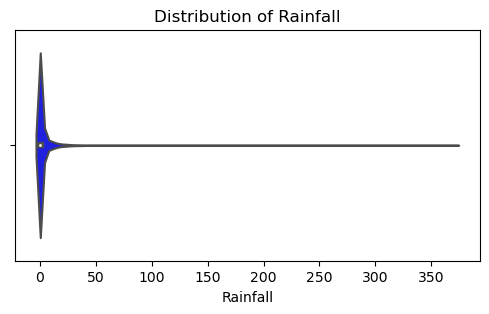

In [29]:
# Visualizing It
plt.figure(figsize=(6,3))
sns.violinplot(x='Rainfall', data=df, color='blue')
plt.title('Distribution of Rainfall')
plt.show()

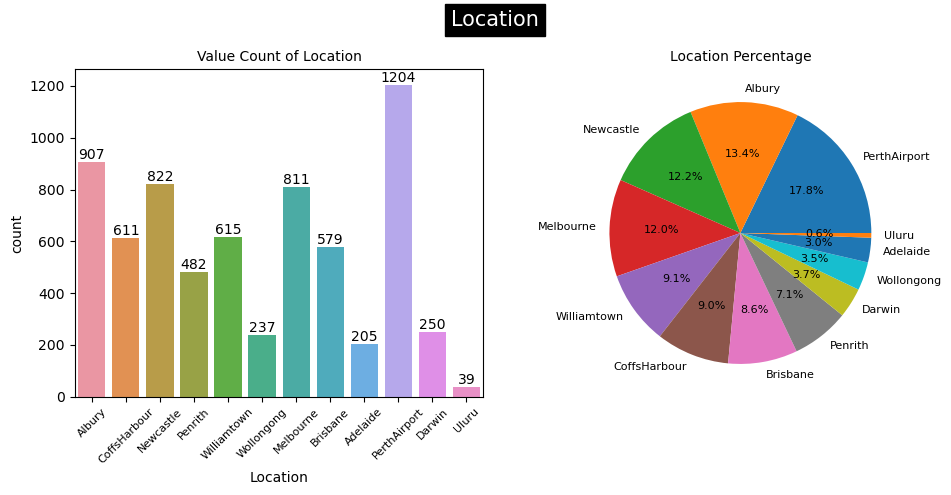

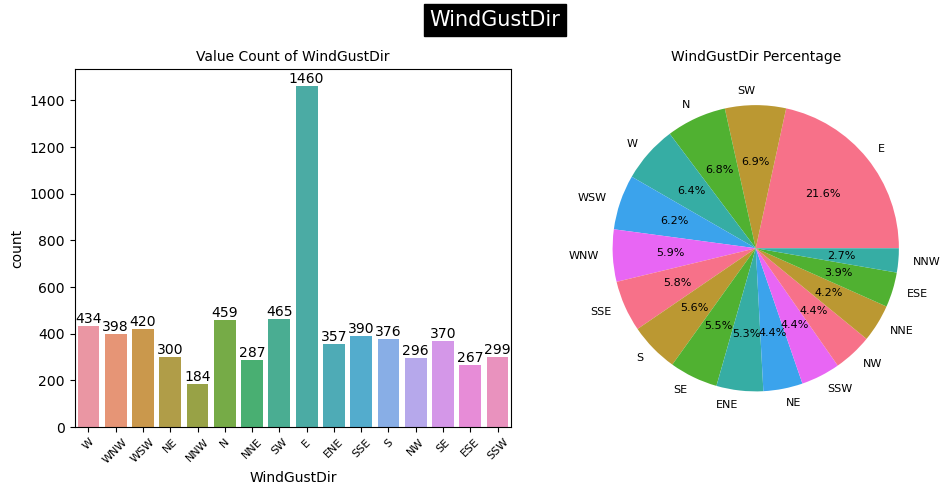

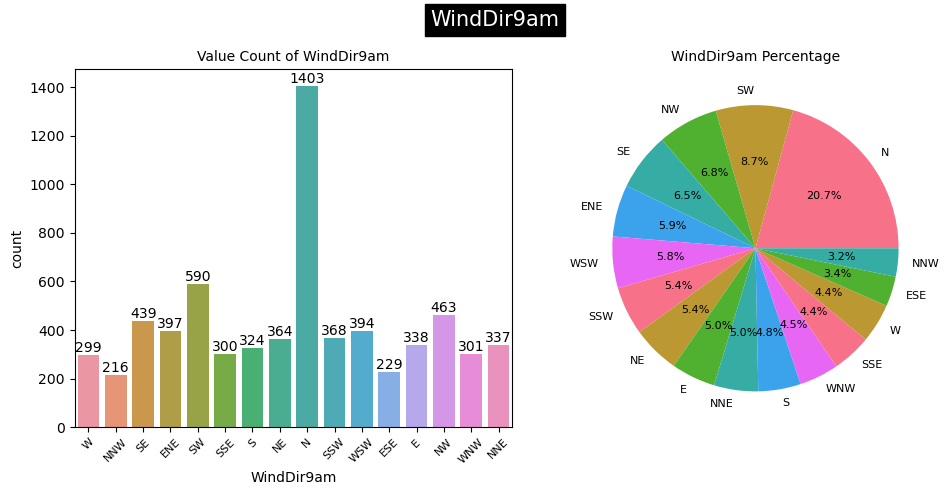

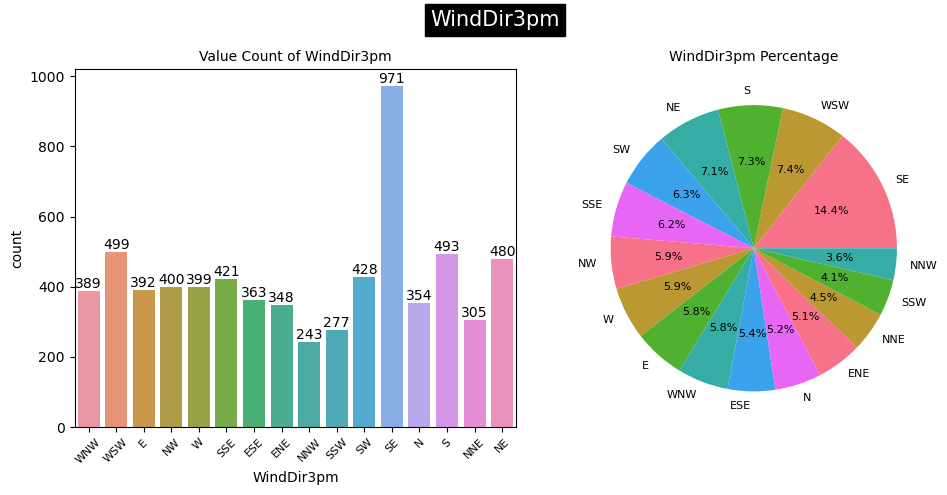

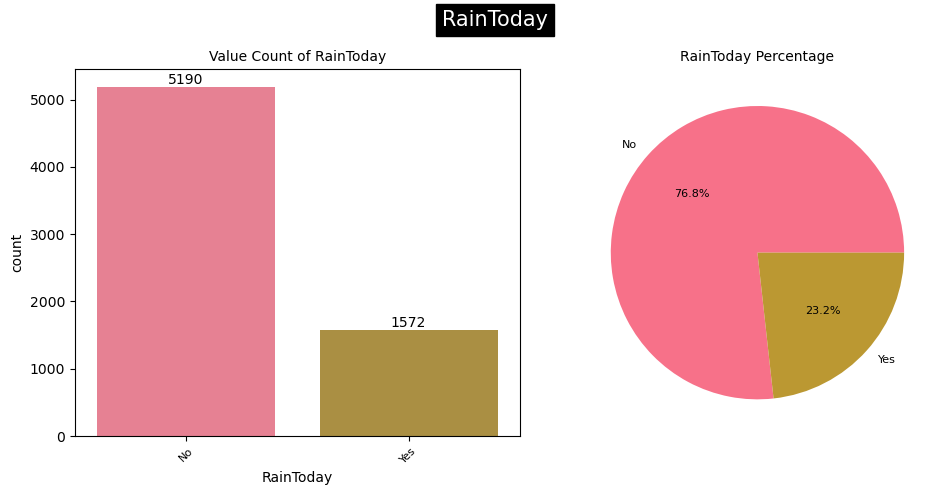

In [30]:
#Visualizing it
cat_col = categorical_columns[:-1]

#Iterate over Categorical column
for i, column in enumerate(cat_col):
    
    fig, axes = plt.subplots(1, 2, figsize=(10,5))
    sns.set_palette("husl")
    
    # Plot the countplot
    ax = sns.countplot(x=column, data=df, ax=axes[0])
    for container in ax.containers:
        ax.bar_label(container)
    ax.set_title(f'Value Count of {column}', fontsize=10)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, fontsize=8)

    # Plot the pie chart
    column_counts = df[column].value_counts()
    ax = axes[1]
    ax.pie(column_counts, labels=column_counts.index, autopct='%0.1f%%', textprops={'fontsize': 8})
    ax.set_title(f'{column} Percentage', fontsize=10)
    
    fig.suptitle(column, fontsize=15, backgroundcolor='black',color='white')
    plt.tight_layout()
    plt.show()

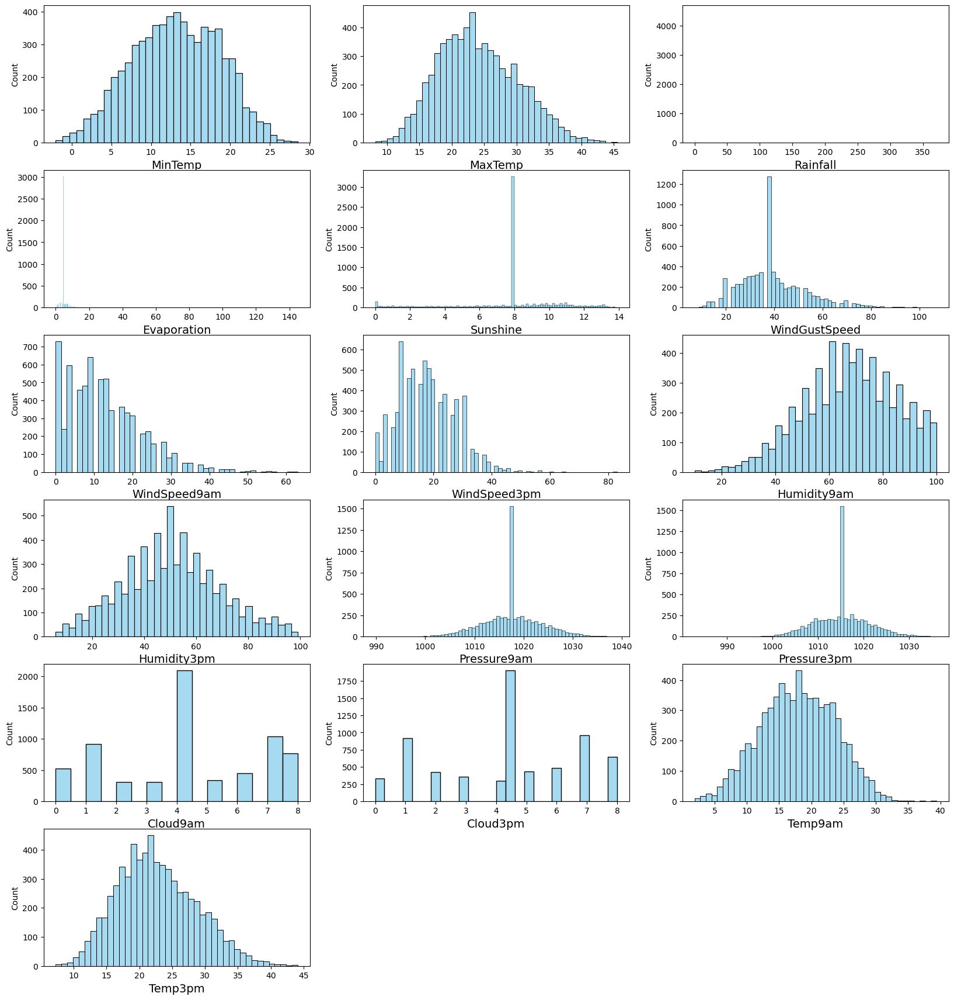

In [31]:
#Visiualizing it using Histogram
plt.figure(figsize=(20,25), facecolor='white')
plotnumber =1
for column in numerical_columns:
    if plotnumber <=20:
        ax = plt.subplot(7,3,plotnumber)
        sns.histplot(df[column], color='skyblue')
        plt.xlabel(column,fontsize=14)
    plotnumber+=1
plt.show()

# BIVARIATE ANALYSIS THROUGH DATA VISUALIZATION

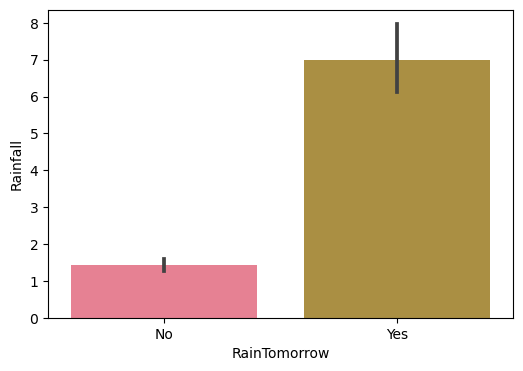

In [32]:
# RainTomorrow Vs Rainfall
plt.figure(figsize=(6,4))
sns.barplot(x=df['RainTomorrow'], y=df['Rainfall'])
plt.show()

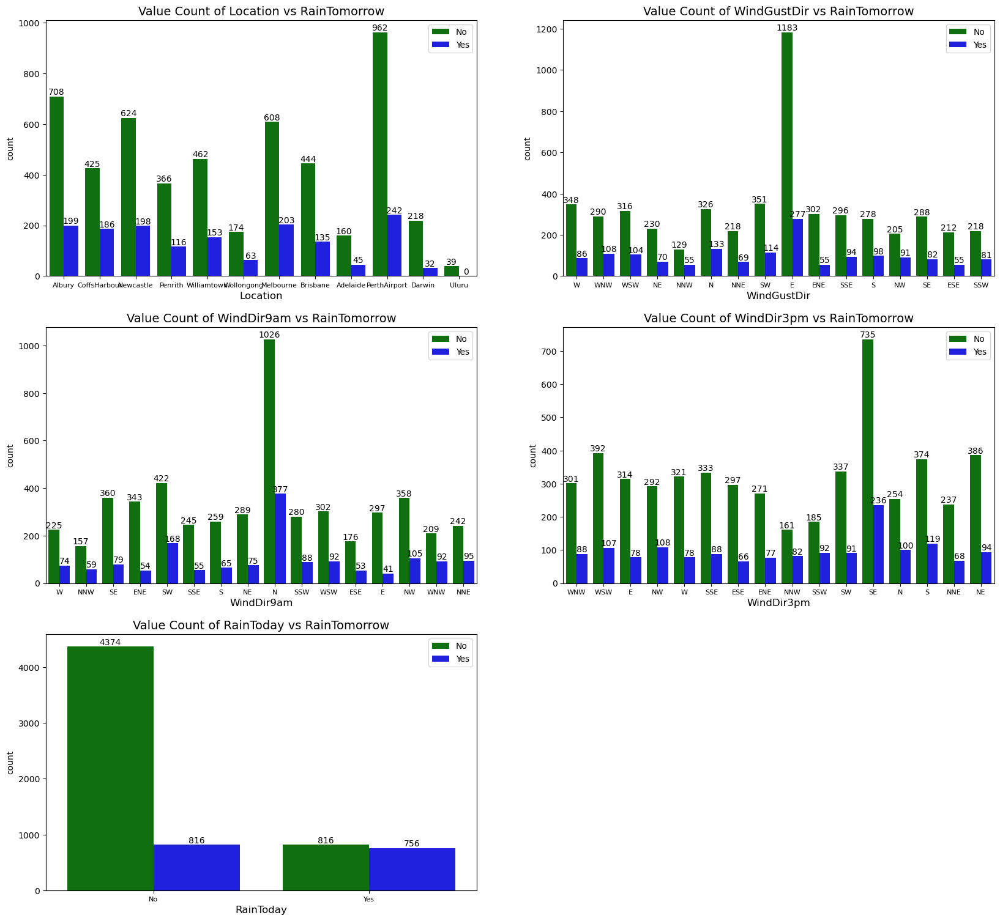

In [33]:
# Visualization of Categorical column Vs RainTomorrow
plt.figure(figsize=(20,25))
p=1

for i in cat_col:
    if p<=8:
        plt.subplot(4,2,p)
        custom_palette = {"Yes": "Blue", "No": "green"}
        ax= sns.countplot(x=i, hue='RainTomorrow',data=df, palette=custom_palette)
        for container in ax.containers:
            ax.bar_label(container)
        plt.title(f'Value Count of {i} vs RainTomorrow', fontsize=14)
        plt.xlabel(i, fontsize=12)
        plt.xticks(fontsize=8)
        plt.legend()
    p+=1
plt.show()

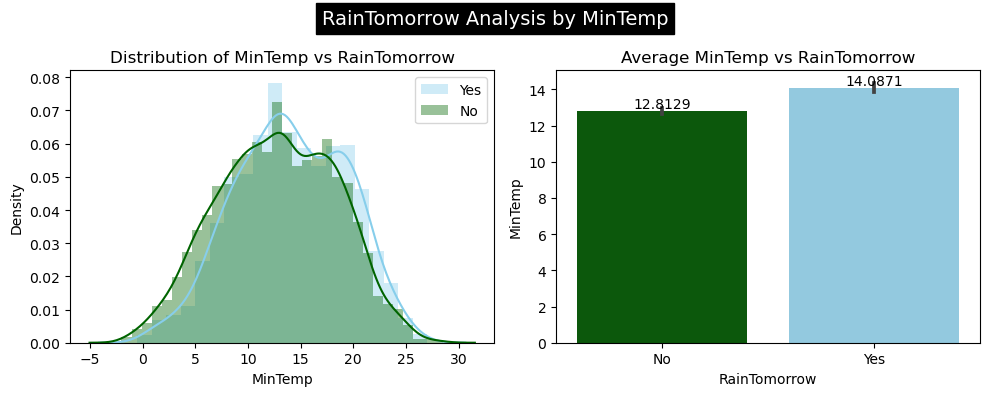

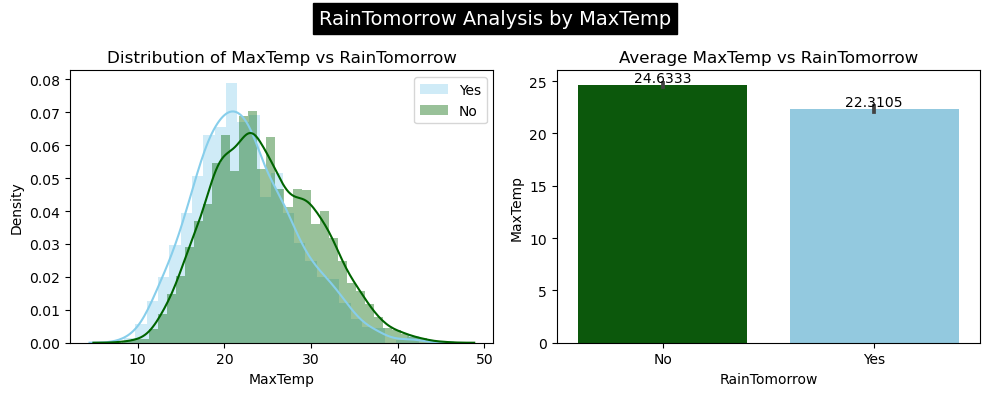

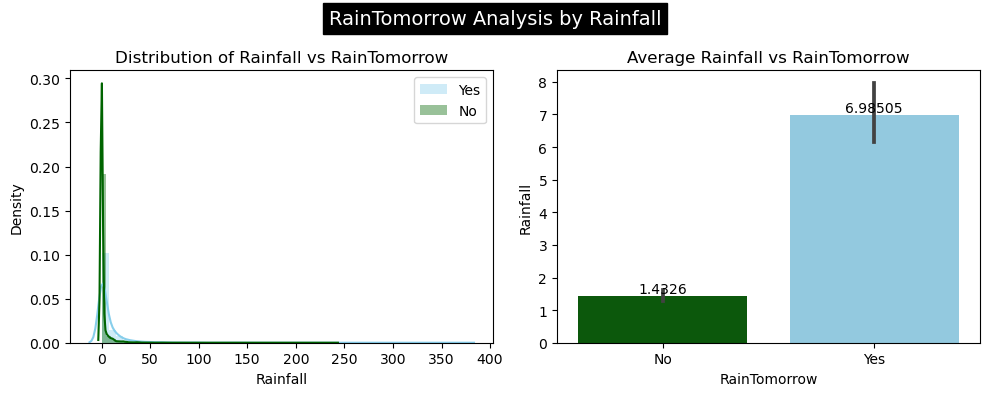

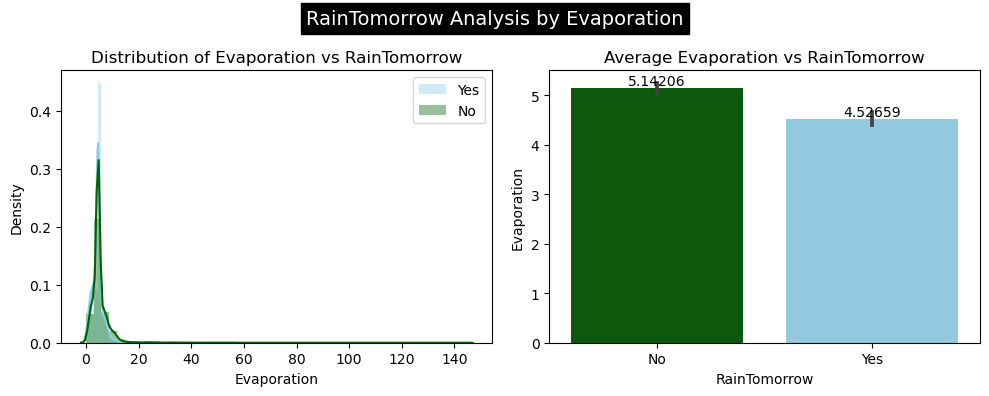

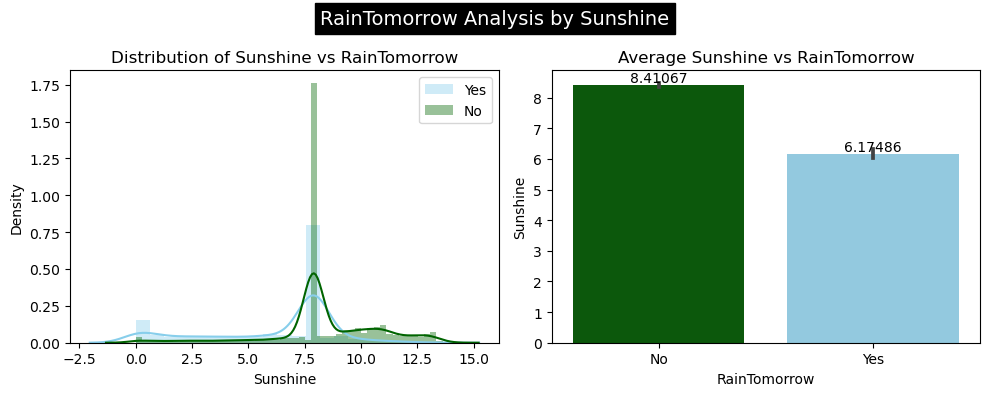

...

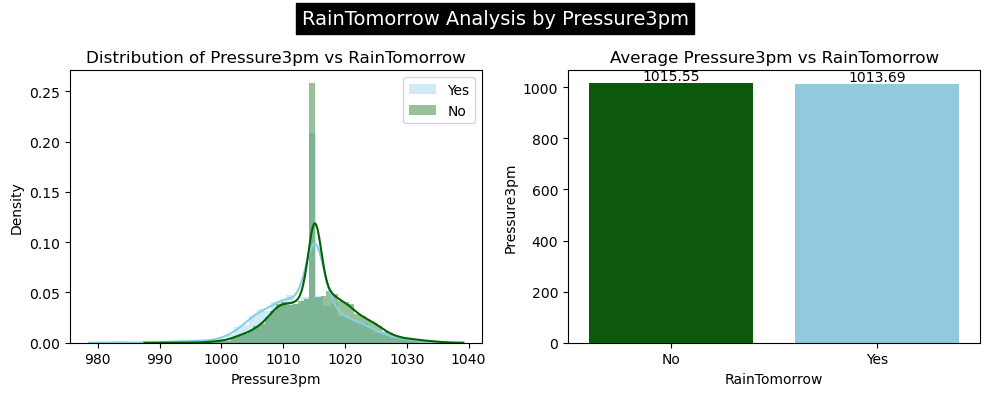

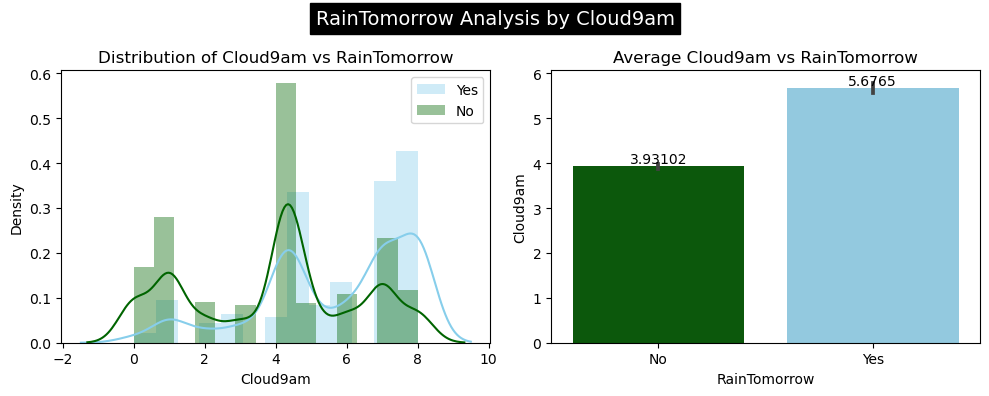

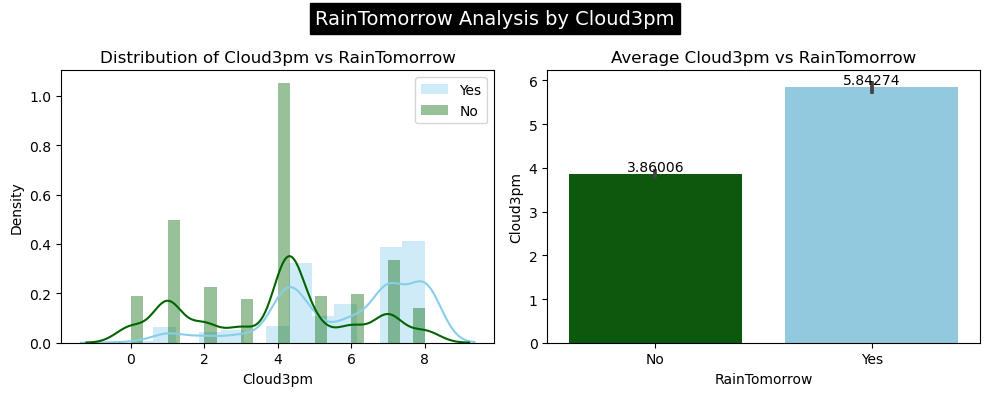

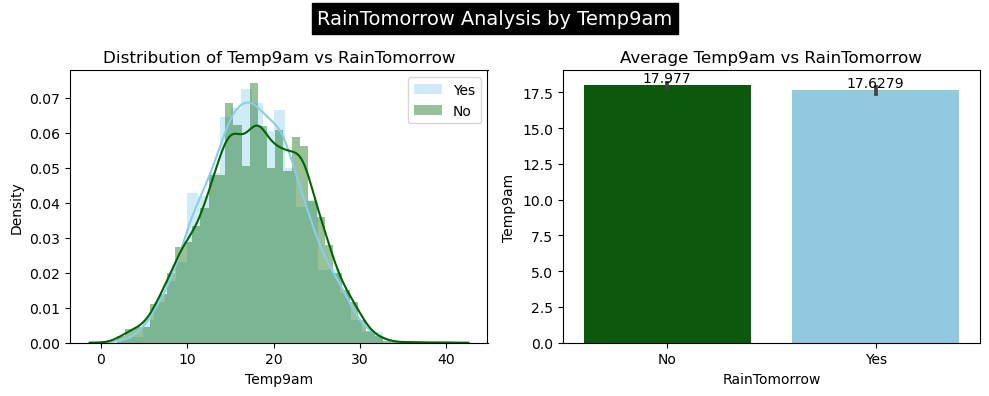

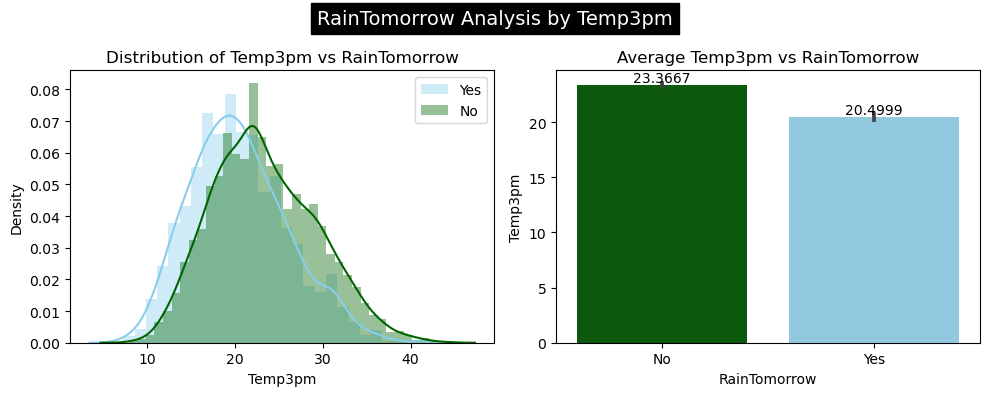

In [34]:
# Visualizing of Numerical column Vs RainTomorrow:
for i in numerical_columns:
    
    #create Subplots
    fig, axes =plt.subplots(1,2,figsize=(10,4))
    
    # First Plot: Distribution of Numerical columns vs RainTomorrow
    sns.distplot(df[df['RainTomorrow']=="Yes"][i], label= "Yes", color='skyblue', ax=axes[0])
    sns.distplot(df[df['RainTomorrow']=="No"][i],label="No", color='Darkgreen', ax=axes[0])
    axes[0].set_title(f"Distribution of {i} vs RainTomorrow")
    axes[0].legend()
    
    # Second Plot: Avg. Numerical columns vs Income
    ax=sns.barplot(x='RainTomorrow', y=i, data=df, palette={"Yes": "skyblue", "No": "Darkgreen"}, ax=axes[1])
    for container in ax.containers:
        ax.bar_label(container)
    axes[1].set_title(f'Average {i} vs RainTomorrow')
    
    fig.suptitle(f"RainTomorrow Analysis by {i}", fontsize=14, backgroundcolor='black',color='white')
    
    # Adjust layout to prevent overlapping
    plt.tight_layout()
    # Show the plots
    plt.show()

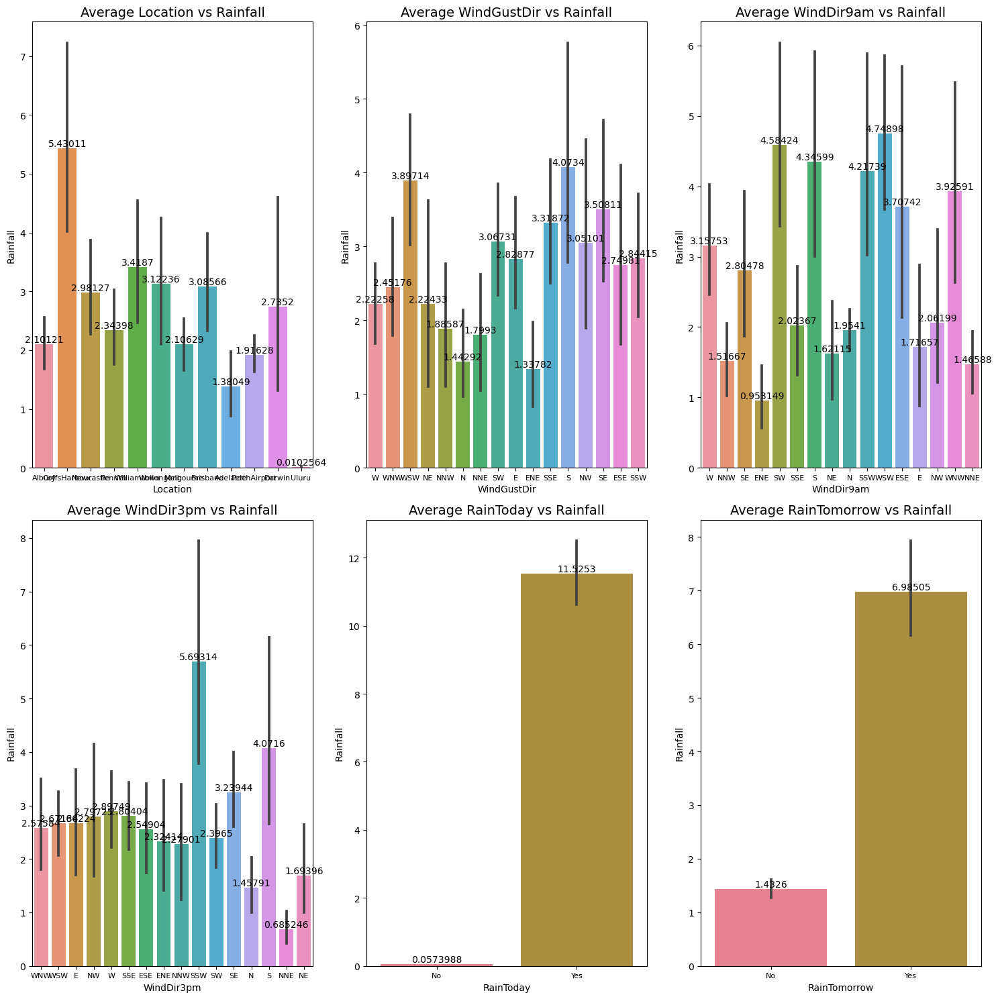

In [35]:
# Visualization of Categorical column Vs Rainfall
plt.figure(figsize=(15, 15))
p = 1

for i in categorical_columns:
    if p <= 6:
        plt.subplot(2, 3, p)
        ax = sns.barplot(x=i, y='Rainfall', data=df)
        for container in ax.containers:
            ax.bar_label(container)
        plt.title(f'Average {i} vs Rainfall', fontsize=14)
        plt.xticks(fontsize=8)
    p += 1

plt.tight_layout()
plt.show()

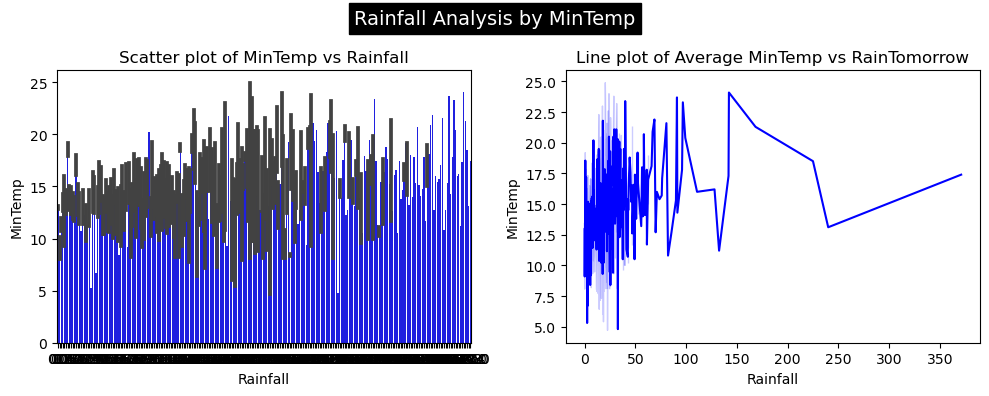

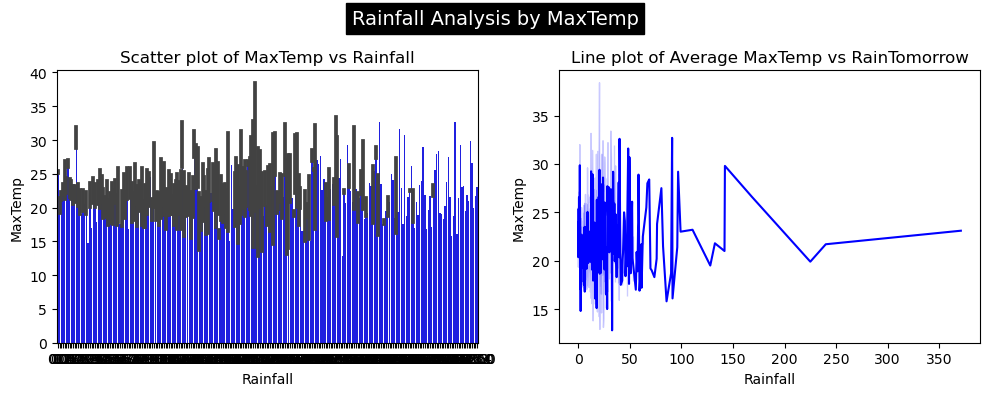

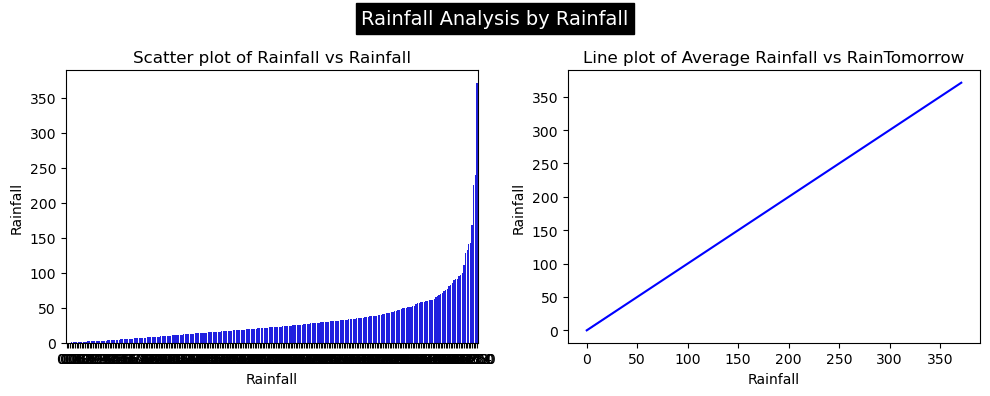

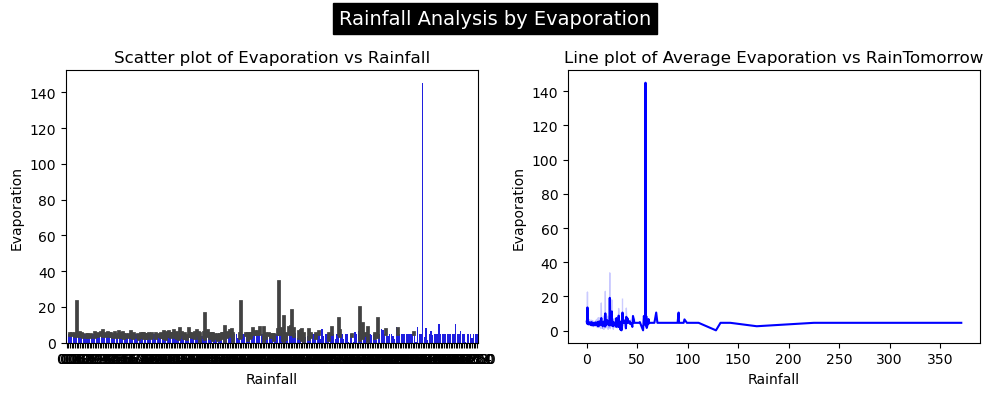

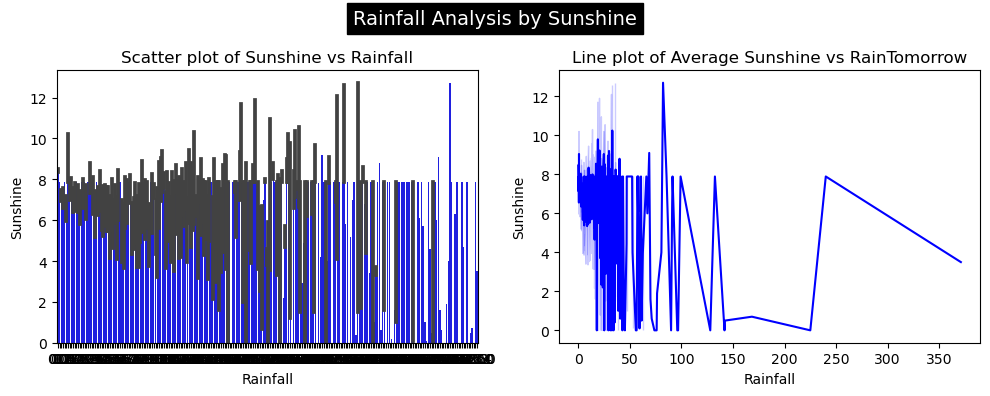

...

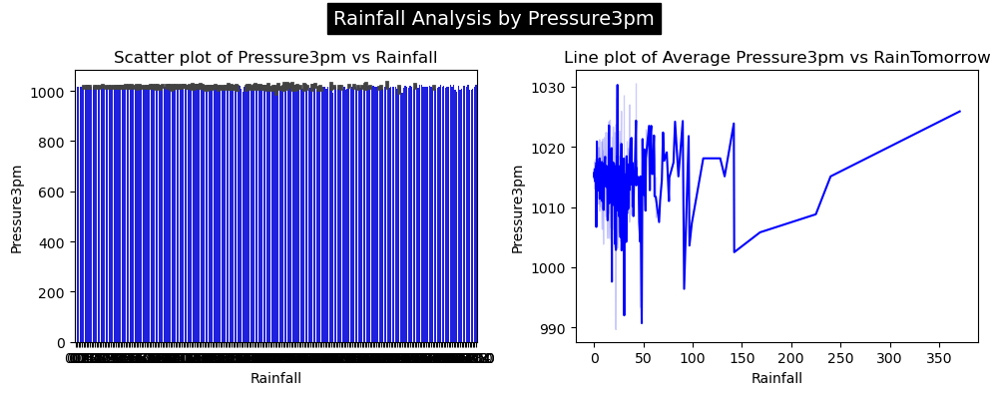

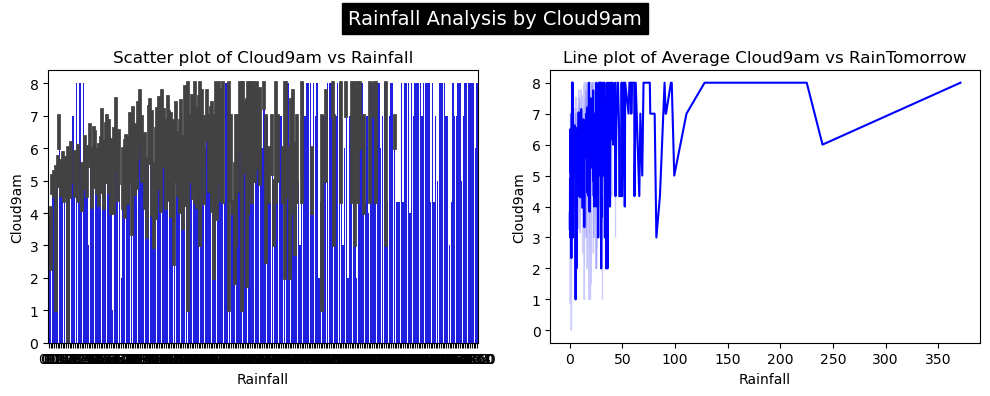

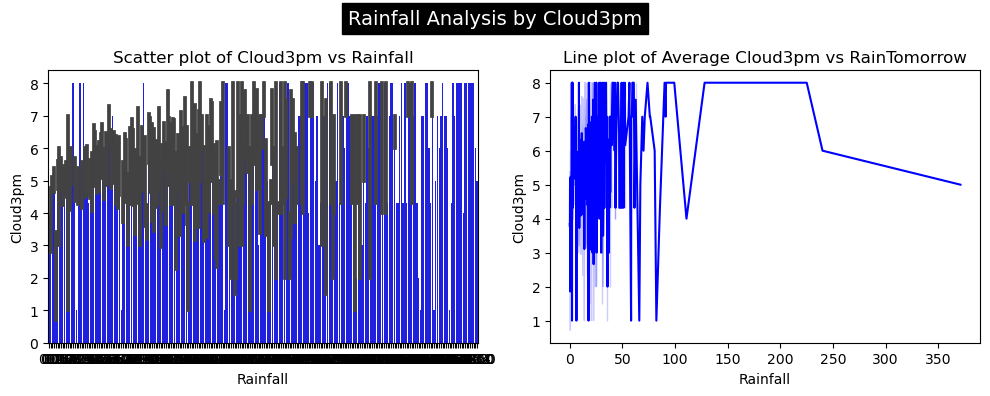

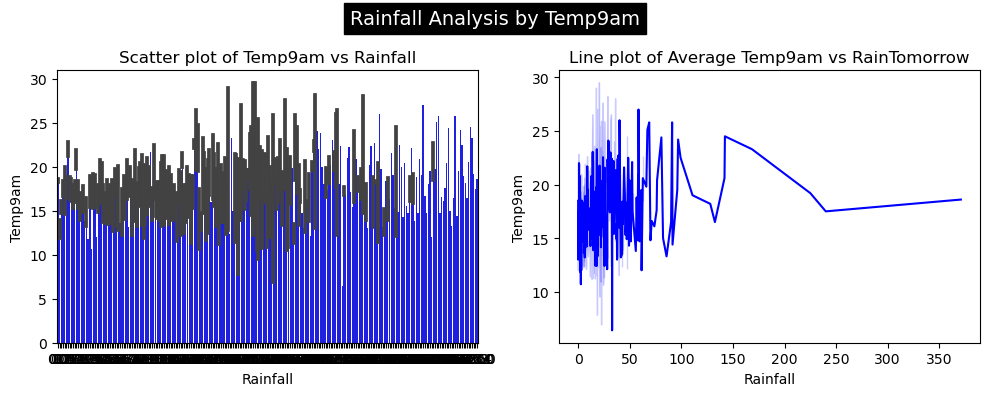

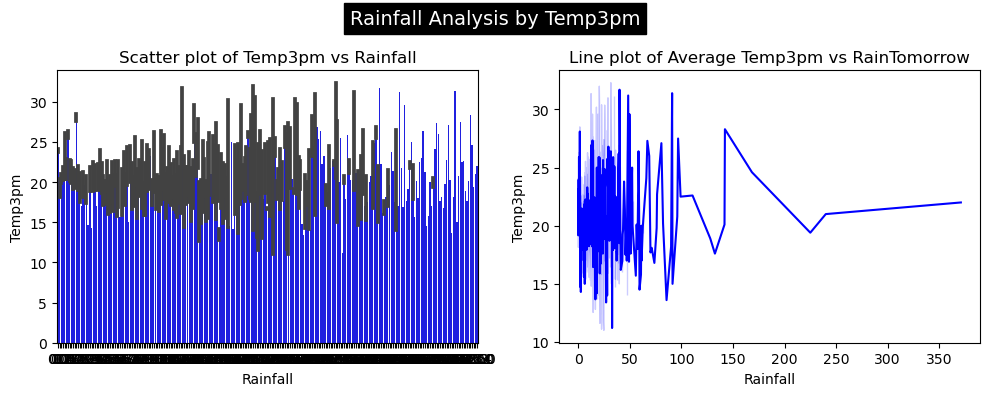

In [36]:
# Visualizing it:
for i in numerical_columns:
    
    # Create Subplots
    fig, axes = plt.subplots(1, 2, figsize=(10, 4))
    
    # First Plot: Scatter plot of Numerical columns vs Rainfall
    sns.barplot(x='Rainfall', y=i, data=df, color='blue', ax=axes[0])
    axes[0].set_title(f"Scatter plot of {i} vs Rainfall")
    
    # Second Plot: Line plot of Avg. Numerical columns vs Rainfall
    ax = sns.lineplot(x='Rainfall', y=i, data=df, color='blue', ax=axes[1])
    axes[1].set_title(f'Line plot of Average {i} vs RainTomorrow')
    
    fig.suptitle(f"Rainfall Analysis by {i}", fontsize=14, backgroundcolor='black', color='white')
    
    # Adjust layout to prevent overlapping
    plt.tight_layout()
    # Show the plots
    plt.show()

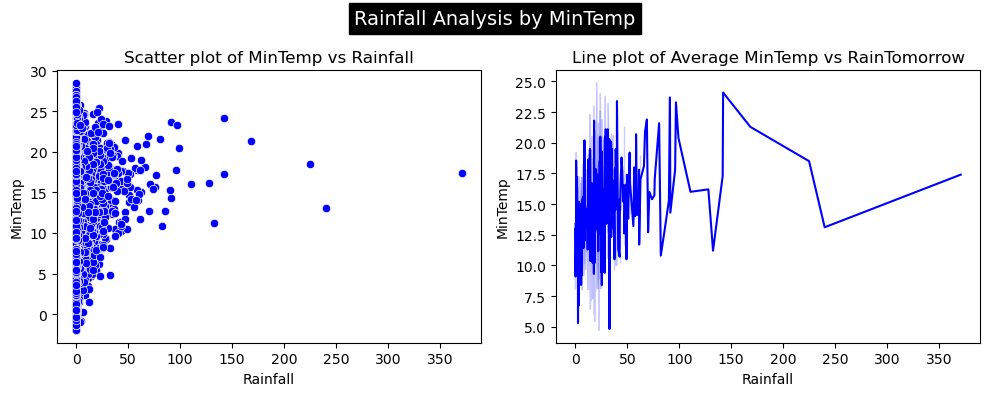

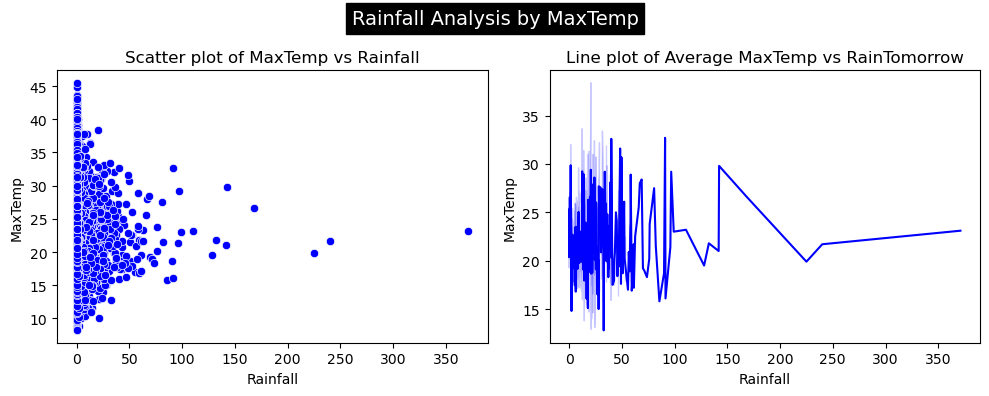

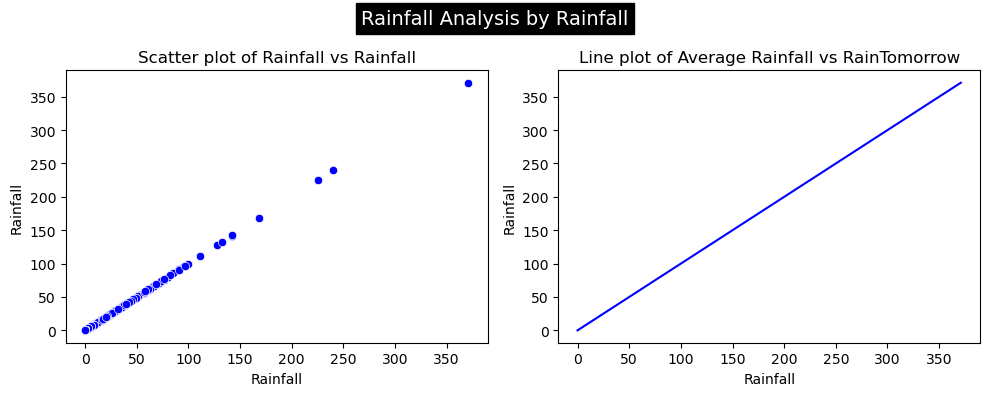

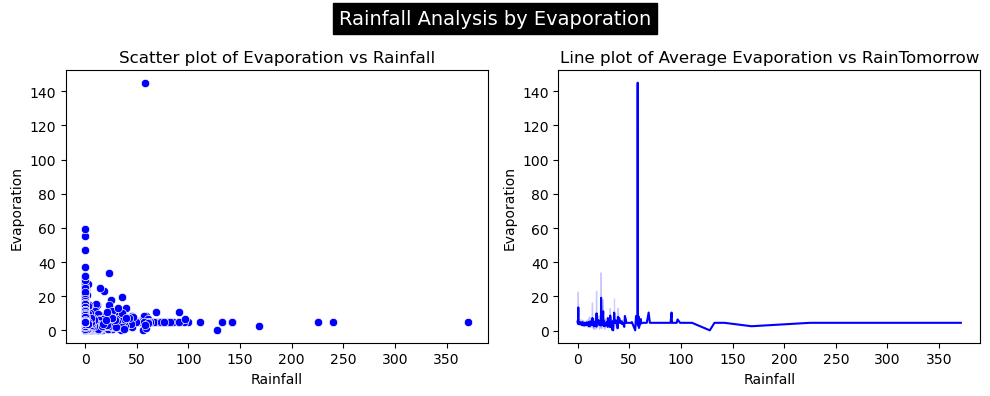

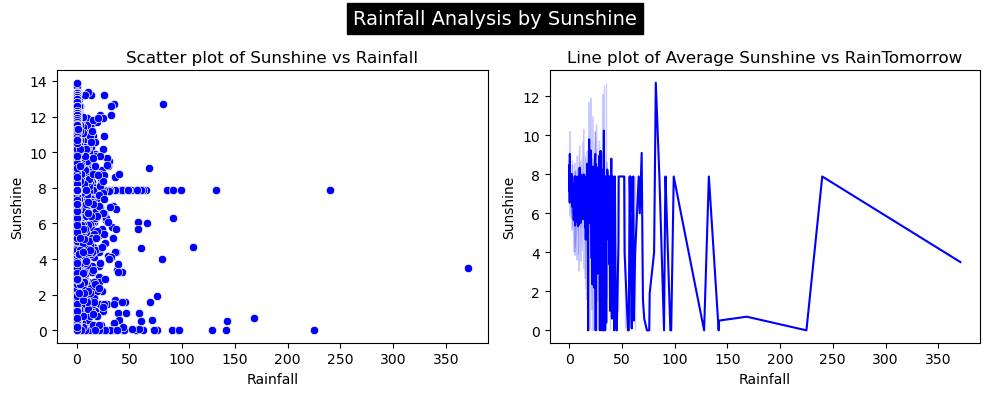

...

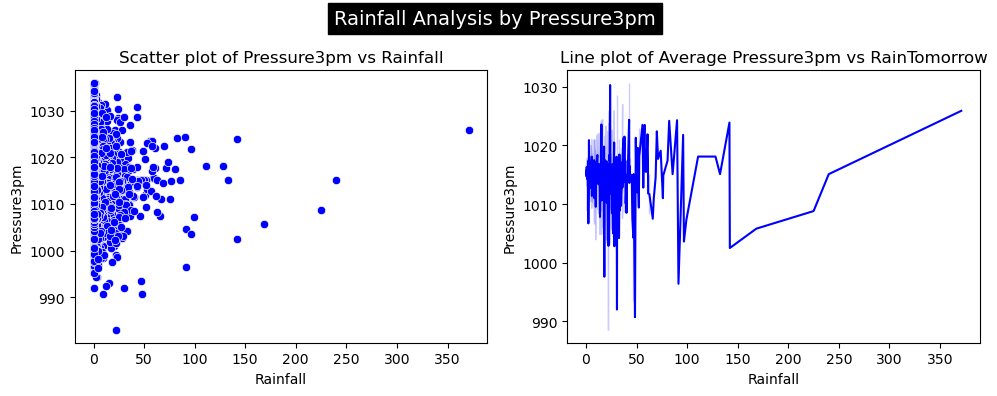

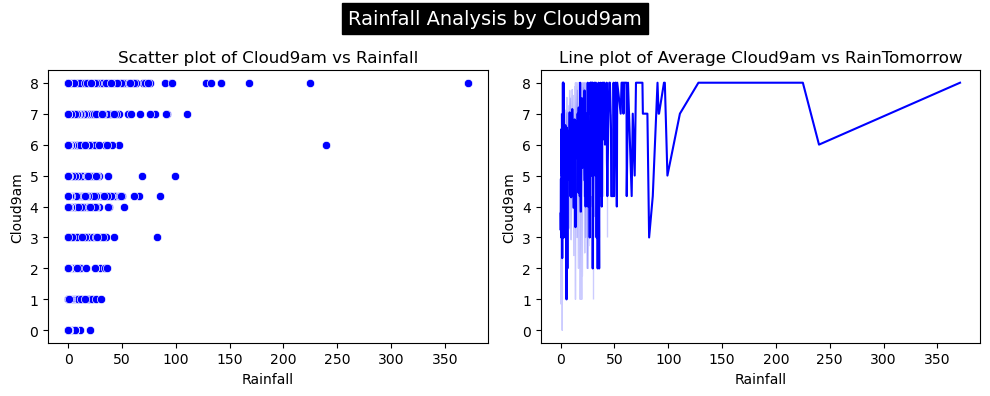

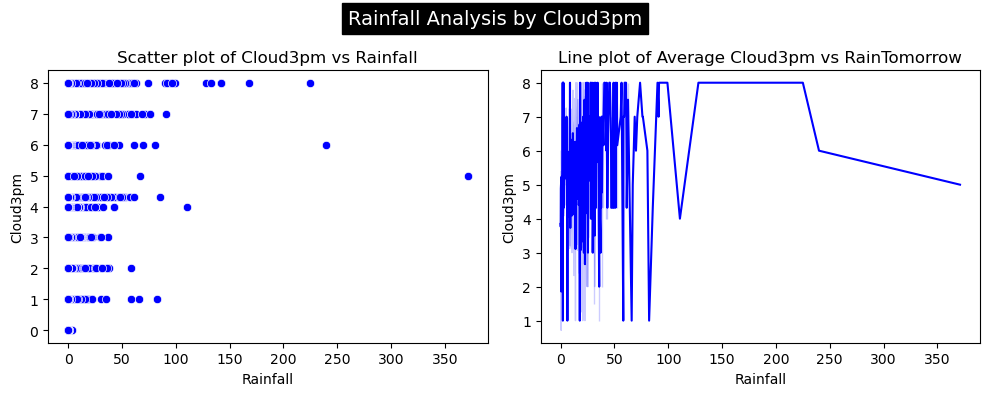

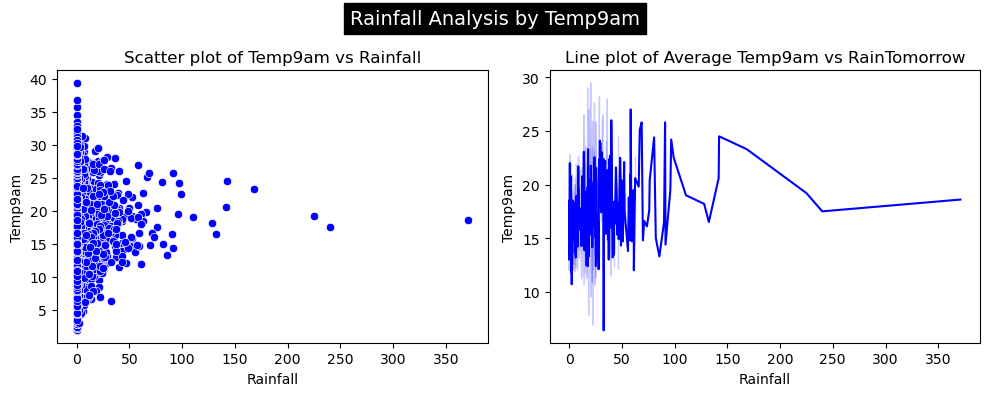

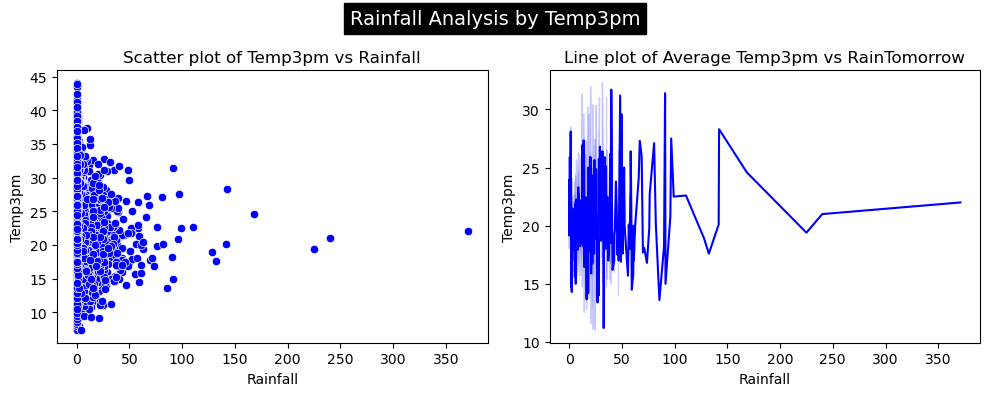

In [37]:
# Visualizing it:
for i in numerical_columns:
    
    # Create Subplots
    fig, axes = plt.subplots(1, 2, figsize=(10, 4))
    
    # First Plot: Scatter plot of Numerical columns vs Rainfall
    sns.scatterplot(x='Rainfall', y=i, data=df, color='blue', ax=axes[0])
    axes[0].set_title(f"Scatter plot of {i} vs Rainfall")
    
    # Second Plot: Line plot of Avg. Numerical columns vs Rainfall
    ax = sns.lineplot(x='Rainfall', y=i, data=df, color='blue', ax=axes[1])
    axes[1].set_title(f'Line plot of Average {i} vs RainTomorrow')
    
    fig.suptitle(f"Rainfall Analysis by {i}", fontsize=14, backgroundcolor='black', color='white')
    
    # Adjust layout to prevent overlapping
    plt.tight_layout()
    # Show the plots
    plt.show()


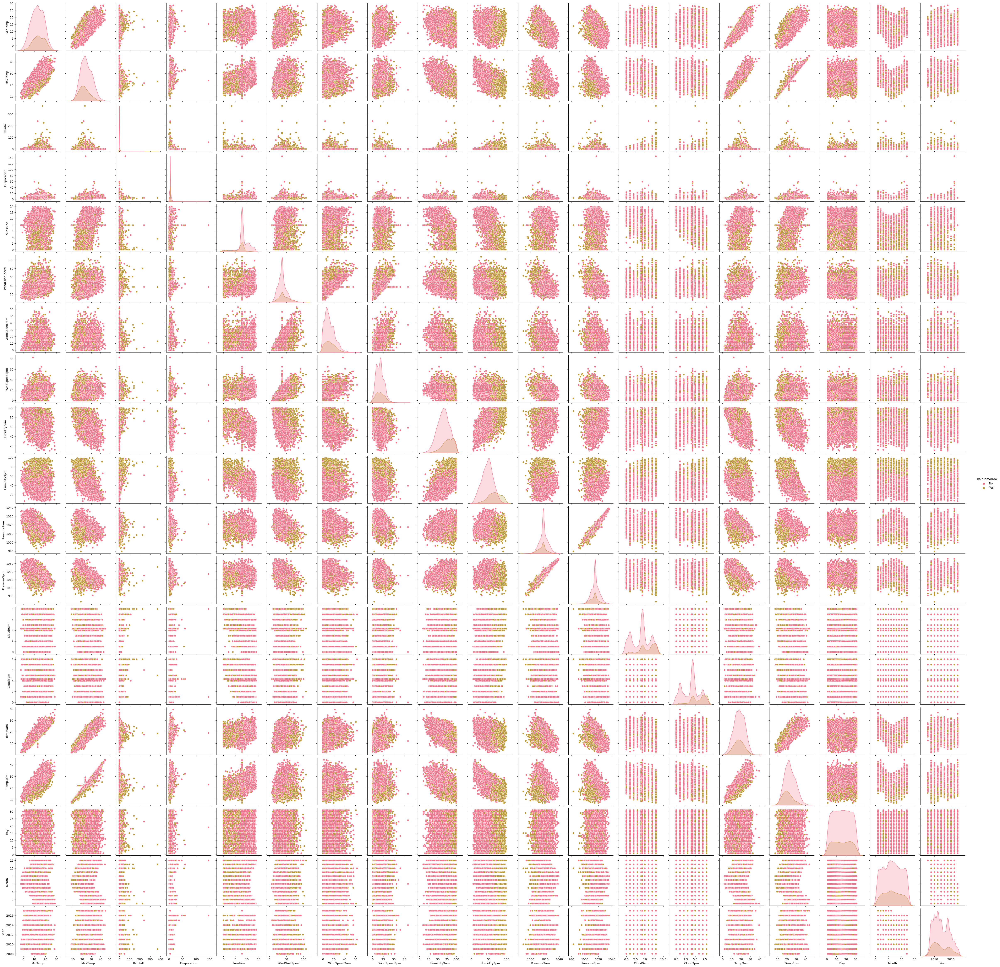

In [38]:
sns.pairplot( df, hue='RainTomorrow' )
plt.show()

# OUTLIER DETECTION AND REMOVAL

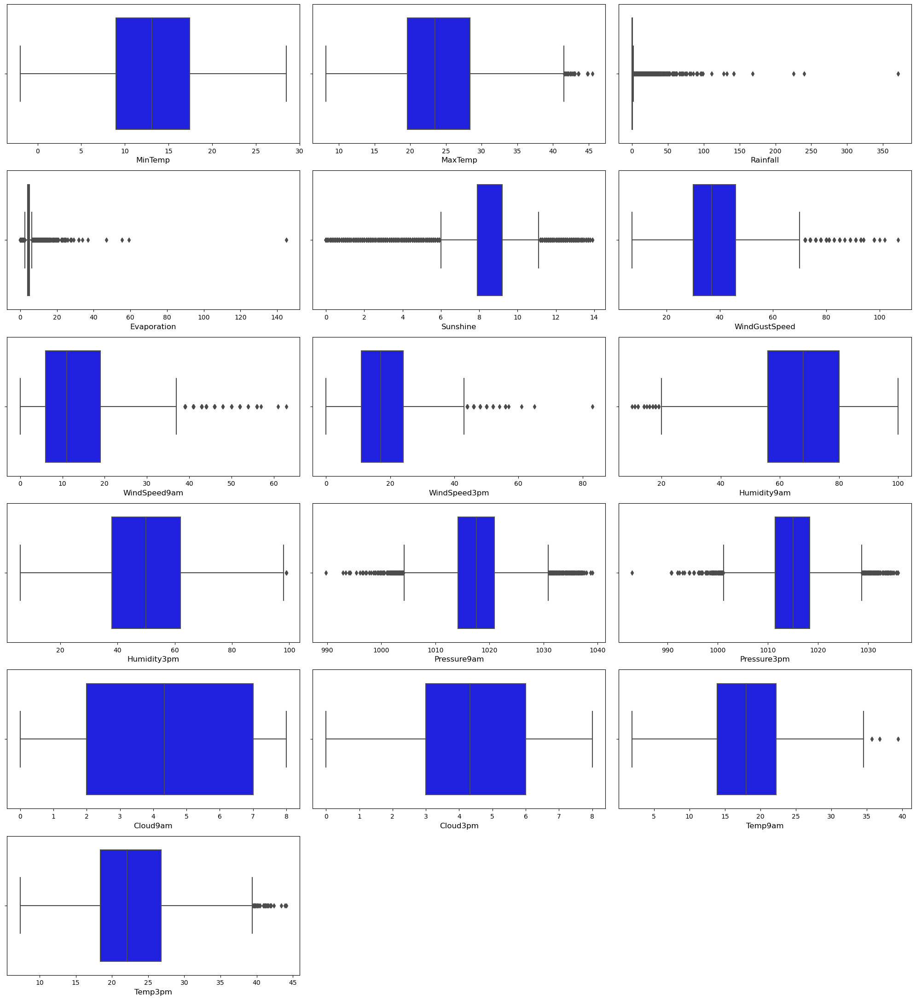

In [39]:
# Identifying the outliers present in numerical columns using boxplot
plt.figure(figsize=(20,25))
plotnumber=1
for col in numerical_columns:
    if plotnumber<=20:
        ax=plt.subplot(7,3,plotnumber)
        sns.boxplot(x=col, data=df,color='blue')
        plt.xlabel(col,fontsize=12)
    plotnumber+=1
plt.tight_layout()

OUTLIER TREATMENT USING Z SCORE METHOD

In [40]:
# Creating a list with Columns which has outliers
outlier_columns=['MaxTemp', 'Rainfall', 'Evaporation',
                 'Sunshine','WindGustSpeed', 'WindSpeed9am',
                 'WindSpeed3pm', 'Humidity9am','Humidity3pm',
                 'Pressure9am', 'Pressure3pm','Temp9am', 'Temp3pm',]


# Calculate the z-scores for the specified numerical columns
z = np.abs(zscore(df[outlier_columns]))

# Create a new DataFrame df1 with rows where z-scores are less than 3 for all numerical columns
df1 = df[(z < 3).all(axis=1)]
df1.shape

(6405, 25)

OUTLIER TREATMENT USING IQR METHOD

In [41]:
df2 = df.copy()

for column in outlier_columns:
    IQR = df2[column].quantile(0.75)-df2[column].quantile(0.25)
    lower_bridge = df2[column].quantile(0.25) - (IQR * 1.5)
    upper_bridge = df2[column].quantile(0.75) + (IQR * 1.5)
    
    # Remove outliers
    df2 = df2[~((df2[column] < lower_bridge) | (df2[column] > upper_bridge))]

# Print the shape of the DataFrame after outlier removal
print("Shape after outlier removal:", df2.shape)

Shape after outlier removal: (2351, 25)


DATA LOSS CALCULATION THROUGH EACH OUTLIER TREATMENT METHOD

In [42]:
# checking the data loss for zscore
data_loss_zscore = (6762-6405)/6405*100
print('Dataloss using zscore:',data_loss_zscore)

# checking the data loss for IQR
data_loss_IQR = (6405-2351)/6405*100
print('Dataloss using IQR:',data_loss_IQR)

Dataloss using zscore: 5.573770491803279
Dataloss using IQR: 63.294301327088206


THUS AS THERE IS A GREATER LOSS OF DATA THROUGH IQR METHOD HENCE IT IS NOT PREFERED AS THAT MIGHT LEAD TO FALSE PREDICTION. SO ULTIMATELY THE Z SCORE METHOD IS OPTED

In [43]:
# Choosing zscore for outlier treatment
df=df1

# Checking the shape of our dataframe after removing outliers using Zscore
df.shape

(6405, 25)

SAVING THE DATA IN A EXCEL FILE FOR FUTHER USE

In [44]:
#Saving Clean Data
file_path = "clean_data_Rainfall.csv"
df.to_csv(file_path, index=False)

# SKEWNESS DETECTION AND TREATMENT

In [45]:
df.skew()

MinTemp         -0.078085
MaxTemp          0.267864
Rainfall         3.520665
Evaporation      1.118992
Sunshine        -0.889339
WindGustSpeed    0.545596
WindSpeed9am     0.682369
WindSpeed3pm     0.344082
Humidity9am     -0.234330
Humidity3pm      0.156516
Pressure9am      0.066558
Pressure3pm      0.092315
Cloud9am        -0.203078
Cloud3pm        -0.146885
Temp9am         -0.071905
Temp3pm          0.293455
Day              0.005249
Month            0.032796
Year             0.352952
dtype: float64

THE DATA IS NOT PROPERLY SKEWED AND NEEDS TO BE TRANSFORMED USING POWER TRANSFORMER TO ADJUST IN COLUMN ['Rainfall', 'Evaporation', 'WindSpeed9am']

In [46]:
# Columns to be transformed
skew_columns = ['Rainfall', 'Evaporation', 'WindSpeed9am']

# Initialize the PowerTransformer
scaler = PowerTransformer(method='yeo-johnson')

df[skew_columns] = scaler.fit_transform(df[skew_columns].values)

# Checking Skewness after treating skewness
df.skew()

MinTemp         -0.078085
MaxTemp          0.267864
Rainfall         1.065122
Evaporation      0.060615
Sunshine        -0.889339
WindGustSpeed    0.545596
WindSpeed9am    -0.130923
WindSpeed3pm     0.344082
Humidity9am     -0.234330
Humidity3pm      0.156516
Pressure9am      0.066558
Pressure3pm      0.092315
Cloud9am        -0.203078
Cloud3pm        -0.146885
Temp9am         -0.071905
Temp3pm          0.293455
Day              0.005249
Month            0.032796
Year             0.352952
dtype: float64

NOW THE DATA IS PROPERLY SKEWED AND READY

# LABEL ENCODING CATEGORICAL COLUMNS IN THE DATASET

In [47]:
# Initating Label Encoder
le = LabelEncoder()

#Iterate over Categorical columns
for i in categorical_columns:
    df[i] = le.fit_transform(df[i])

df.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,1,13.4,22.9,0.802149,0.019152,7.890896,13,44.0,13,14,...,1007.1,8.000000,4.320988,16.9,21.8,0,0,1,12,2008
1,1,7.4,25.1,-0.646716,0.019152,7.890896,14,44.0,6,15,...,1007.8,4.336806,4.320988,17.2,24.3,0,0,2,12,2008
2,1,12.9,25.7,-0.646716,0.019152,7.890896,15,46.0,13,15,...,1008.7,4.336806,2.000000,21.0,23.2,0,0,3,12,2008
3,1,9.2,28.0,-0.646716,0.019152,7.890896,4,24.0,9,0,...,1012.8,4.336806,4.320988,18.1,26.5,0,0,4,12,2008
4,1,17.5,32.3,1.165262,0.019152,7.890896,13,41.0,1,7,...,1006.0,7.000000,8.000000,17.8,29.7,0,0,5,12,2008


TRANSFORMED SUCCESFULLY ALL THE CATEGORICAL COLUMNS IN THE DATASET TO NUMERICAL COLUMNS ACCORDING TO THEIR VALUES IN EACH COLUMN

# CORRELATION OF DATASET

In [48]:
# Calculate the correlation matrix
df_corr = df.corr()
df_corr


,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
Location,1.000000,0.091711,0.073163,0.003313,0.109779,0.058077,-0.086740,0.269819,-0.102867,-0.000110,...,-0.018292,-0.005569,-0.004753,0.098836,0.069084,-0.004064,0.001047,-0.004824,-0.070775,0.504642
MinTemp,0.091711,1.000000,0.730443,0.071254,0.385046,0.046470,-0.142466,0.244192,-0.021335,-0.143475,...,-0.447498,0.094939,0.044612,0.892863,0.699937,0.072284,0.092327,0.018313,-0.235969,0.034034
MaxTemp,0.073163,0.730443,1.000000,-0.249556,0.488757,0.358502,-0.202044,0.171035,-0.192569,-0.165304,...,-0.425968,-0.240513,-0.239326,0.865546,0.975189,-0.219597,-0.158306,0.019890,-0.172224,0.083746
Rainfall,0.003313,0.071254,-0.249556,1.000000,-0.213268,-0.271955,0.112559,0.070265,0.152918,0.113943,...,-0.029997,0.318495,0.277897,-0.107258,-0.260766,0.931729,0.329587,-0.009313,-0.006195,0.007281
Evaporation,0.109779,0.385046,0.488757,-0.213268,1.000000,0.416652,-0.121925,0.213578,-0.113451,-0.028743,...,-0.306972,-0.132476,-0.176777,0.455848,0.475805,-0.184877,-0.111478,0.007102,-0.041669,0.092125
Sunshine,0.058077,0.046470,0.358502,-0.271955,0.416652,1.000000,-0.094801,0.039405,-0.078618,-0.053638,...,-0.084836,-0.534641,-0.557336,0.243782,0.376608,-0.237414,-0.333100,-0.001910,0.003092,0.053708
WindGustDir,-0.086740,-0.142466,-0.202044,0.112559,-0.121925,-0.094801,1.000000,0.023365,0.381934,0.456003,...,-0.006673,0.113068,0.073411,-0.158453,-0.212044,0.108370,0.033716,0.016802,0.032303,-0.184168
WindGustSpeed,0.269819,0.244192,0.171035,0.070265,0.213578,0.039405,0.023365,1.000000,-0.062442,0.089590,...,-0.326115,0.002130,0.036652,0.224791,0.139337,0.078237,0.163852,-0.002839,0.047766,-0.032164
WindDir9am,-0.102867,-0.021335,-0.192569,0.152918,-0.113451,-0.078618,0.381934,-0.062442,1.000000,0.207862,...,0.058139,0.070301,0.053819,-0.067128,-0.200892,0.149877,0.034460,-0.007582,0.020991,-0.082950
WindDir3pm,-0.000110,-0.143475,-0.165304,0.113943,-0.028743,-0.053638,0.456003,0.089590,0.207862,1.000000,...,-0.041407,0.069949,0.048944,-0.150248,-0.176879,0.095332,-0.000168,0.001450,0.029916,0.005258


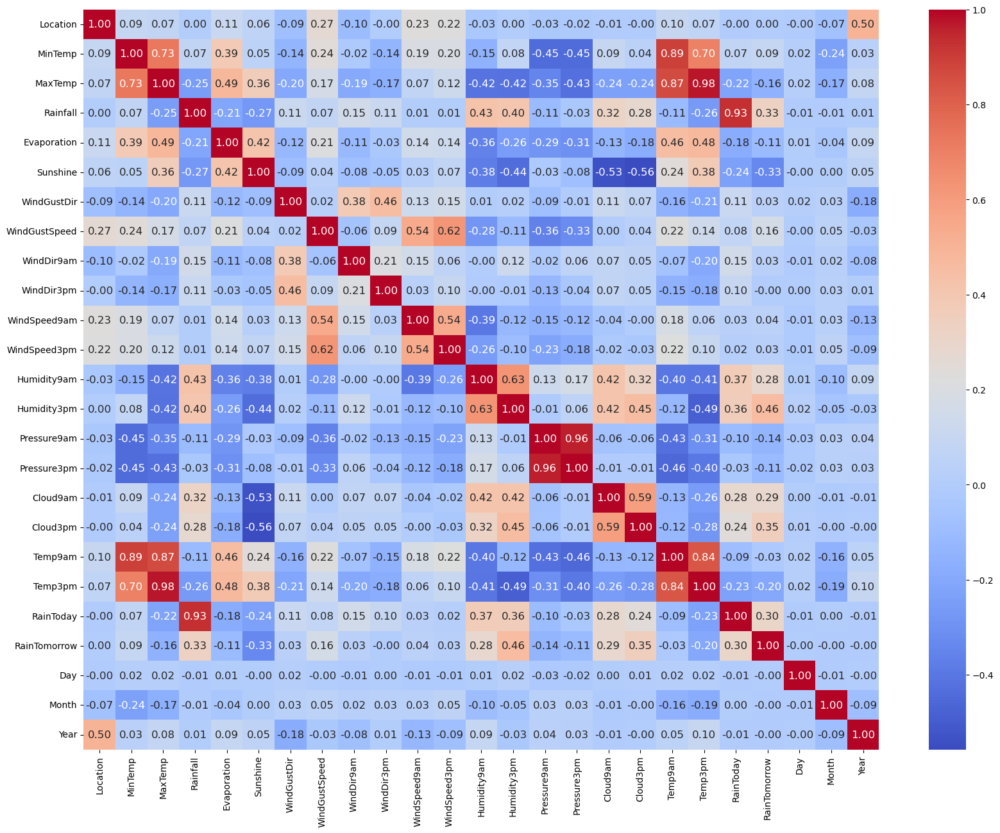

In [49]:
# Visualizing it
plt.figure(figsize=(20, 15))
sns.heatmap(df_corr, annot=True, fmt='.2F', cmap='coolwarm', annot_kws={"size": 12})
plt.show()

In [50]:
# Find the column with the maximum correlation
max_corr_column = df_corr.idxmax(axis=1)[df_corr.max().idxmax()]

print(f'The column with the maximum correlation is: {max_corr_column}')


The column with the maximum correlation is: Location


In [51]:
# Find the columns with the maximum correlation
max_corr = 0
max_corr_cols = []
for i in range(len(df_corr.columns)):
    for j in range(i):
        if abs(df_corr.iloc[i, j]) > max_corr:
            max_corr = abs(df_corr.iloc[i, j])
            max_corr_cols = [df_corr.columns[i], df_corr.columns[j]]

print(f"Columns with maximum correlation: {max_corr_cols} with correlation value of {max_corr}")

Columns with maximum correlation: ['Temp3pm', 'MaxTemp'] with correlation value of 0.9751888500073052


In [52]:
df.corr().abs().unstack().sort_values(ascending=False)


Location      Location        1.000000
Humidity3pm   Humidity3pm     1.000000
Rainfall      Rainfall        1.000000
Evaporation   Evaporation     1.000000
Sunshine      Sunshine        1.000000
                                ...   
Location      Humidity3pm     0.000535
WindDir3pm    RainTomorrow    0.000168
RainTomorrow  WindDir3pm      0.000168
WindDir3pm    Location        0.000110
Location      WindDir3pm      0.000110
Length: 625, dtype: float64

In [53]:
# dropping irrelevant columns
df.drop(columns=['Pressure3pm', 'Temp3pm', 'Temp9am', 'RainToday'],axis=1,inplace=True)

In [54]:
df.shape

(6405, 21)

COPYING THE DATAFRAME FOR OUR TWO PREDICTIONS

In [55]:
df1 =df.copy()

FINDING CORRELATION OF THE COLUMN WITH TWO PREDICTION COLUMN AS PER PROJECT DESCRIPTION

In [56]:
#correlation with target column(RainTomorrow)
correlation_with_RainTomorrow = df.corr()['RainTomorrow'].abs().sort_values(ascending=False)
print(correlation_with_RainTomorrow)

RainTomorrow     1.000000
Humidity3pm      0.463724
Cloud3pm         0.350736
Sunshine         0.333100
Rainfall         0.329587
Cloud9am         0.286797
Humidity9am      0.283625
WindGustSpeed    0.163852
MaxTemp          0.158306
Pressure9am      0.139487
Evaporation      0.111478
MinTemp          0.092327
WindSpeed9am     0.041446
WindDir9am       0.034460
WindGustDir      0.033716
WindSpeed3pm     0.026138
Month            0.003892
Year             0.003841
Day              0.002229
Location         0.001047
WindDir3pm       0.000168
Name: RainTomorrow, dtype: float64


Month            0.003892
Year             0.003841
Day              0.002229
Location         0.001047
WindDir3pm       0.000168


SINCE THE ABOVE COLUMNS HAVE VERY LESS OR ALMOST 0 CORRELATION WITH THE COLUMN RAINTOMMOROW THUS THEY ARE IRRELEVANT IN PREDICTING WETHER IT WILL RAIN TOMMROW OR NOT

In [57]:
# dropping irrelevant columns
df.drop(columns=['WindDir3pm','Location','Day','Year', 'Month'],axis=1,inplace=True)

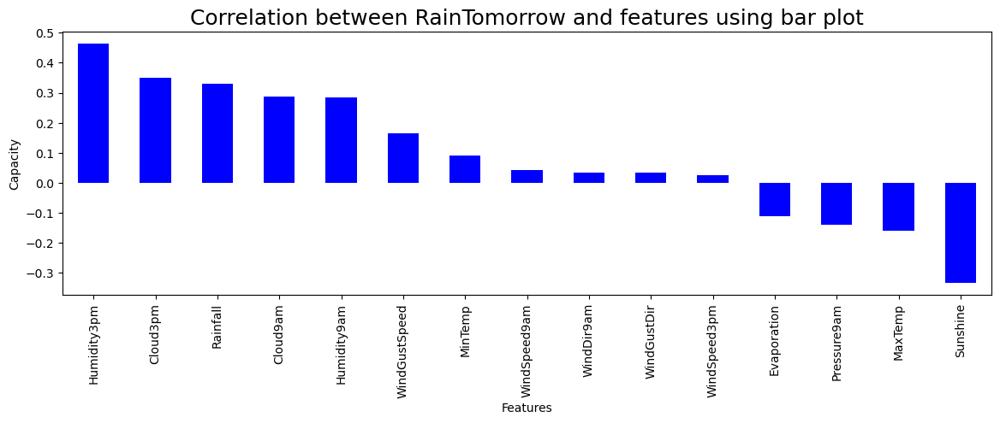

In [58]:
plt.figure(figsize=(14,4))
df.corr()['RainTomorrow'].sort_values(ascending=False).drop(['RainTomorrow']).plot(kind='bar',color='blue')
plt.xlabel('Features',fontsize=10)
plt.ylabel('Capacity',fontsize=10)
plt.title('Correlation between RainTomorrow and features using bar plot',fontsize=18)
plt.show()

In [59]:
df.shape

(6405, 16)

In [60]:
#correlation with target column(RainTomorrow)
correlation_with_Rainfall = df1.corr()['Rainfall'].abs().sort_values(ascending=False)
print(correlation_with_Rainfall)

Rainfall         1.000000
Humidity9am      0.425329
Humidity3pm      0.404194
RainTomorrow     0.329587
Cloud9am         0.318495
Cloud3pm         0.277897
Sunshine         0.271955
MaxTemp          0.249556
Evaporation      0.213268
WindDir9am       0.152918
WindDir3pm       0.113943
WindGustDir      0.112559
Pressure9am      0.107907
MinTemp          0.071254
WindGustSpeed    0.070265
Day              0.009313
WindSpeed3pm     0.007377
WindSpeed9am     0.007322
Year             0.007281
Month            0.006195
Location         0.003313
Name: Rainfall, dtype: float64


Year             0.018796
WindSpeed9am     0.015488
Day              0.011303
WindSpeed3pm     0.008588
Month            0.007633
Location         0.003614


SINCE THE ABOVE COLUMNS HAVE VERY LESS OR ALMOST 0 CORRELATION WITH THA COLUMN RAINFALL THUS IT IS IRRELEVANT IN PREDICTING THE AMOUNT OF RAINFALL

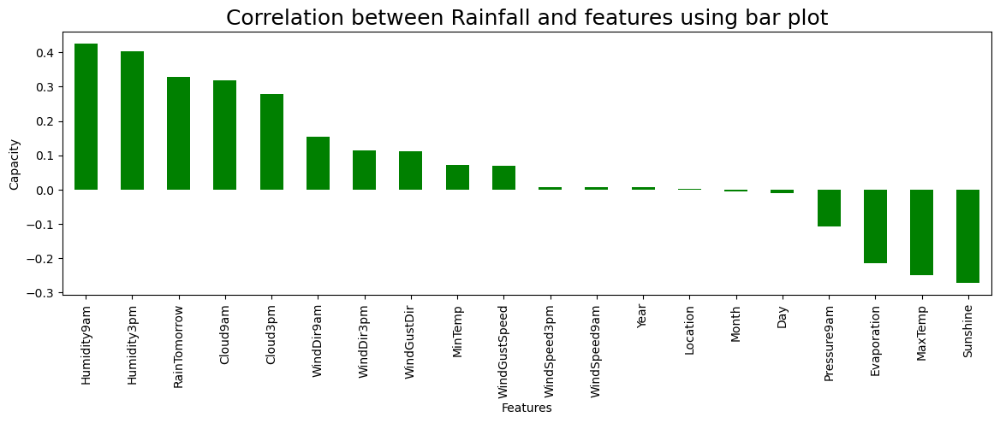

In [61]:
plt.figure(figsize=(14,4))
df1.corr()['Rainfall'].sort_values(ascending=False).drop(['Rainfall']).plot(kind='bar',color='green')
plt.xlabel('Features',fontsize=10)
plt.ylabel('Capacity',fontsize=10)
plt.title('Correlation between Rainfall and features using bar plot',fontsize=18)
plt.show()

In [62]:
df1.drop(columns=['Day', 'WindSpeed3pm', 'WindSpeed9am','Year', 'Month', 'Location'],axis=1,inplace=True)

In [63]:
df1.shape

(6405, 15)

# DATA SPLITTING FOR MODEL PREPARATION AND PREDICTION

SPLITTING DATA FOR PREDICTING WHETHER IT WILL RAIN TOMMOROW OR NOT THROUGH THE RAINTOMMOROW COLUMN

In [64]:
# Splitting data in target and dependent feature
X = df.drop(['RainTomorrow'], axis =1)
Y = df['RainTomorrow']

# Checking the dimenstion of X & Y
X.shape, Y.shape

((6405, 15), (6405,))

SPLIITING DATA TO PREDICT THE AMOUNT OF RAINFALL THROUGH THE RAINFALL COLUMN

In [65]:
# Splitting data in target and dependent feature
X1 = df1.drop(['Rainfall'], axis =1)
Y1 = df1['Rainfall']

# Checking the dimenstion of X1 & Y1
X1.shape, Y1.shape

((6405, 14), (6405,))

# FEATURE ENGINEERING THE SPLITTED DATA FOR BETTER PREDICTIONS

STANDARDISATION AND SCALING FOR OUR FIRST TARGET VARIABLE RAINTOMMOROW

In [66]:
#Instantiate Standard Scaler
scaler= StandardScaler()

# Fit and transform the scaler on the features
X_scale = scaler.fit_transform(X)

# Create a DataFrame view of the scaled features after preprocessing
X = pd.DataFrame(X_scale, columns=X.columns)
X

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Cloud9am,Cloud3pm
0,0.069957,-0.189586,0.802149,0.019152,-0.018878,1.222871,0.506587,1.317529,0.907717,0.757422,0.199656,-1.560526,-1.759471,1.496298,0.018004
1,-1.013228,0.175602,-0.646716,0.019152,-0.018878,1.413823,0.506587,-0.222754,-0.856432,0.536834,-1.396033,-1.395549,-1.252405,0.014970,0.018004
2,-0.020308,0.275199,-0.646716,0.019152,-0.018878,1.604776,0.669986,1.317529,0.825275,0.978010,-1.750630,-1.120587,-1.776956,0.014970,-0.982944
3,-0.688272,0.656987,-0.646716,0.019152,-0.018878,-0.495701,-1.127400,0.437367,0.070417,-0.896990,-1.336933,-1.890480,-0.028454,0.014970,0.018004
4,0.810134,1.370764,1.165262,0.019152,-0.018878,1.222871,0.261489,-1.322957,-0.408178,0.316245,0.849752,-0.955609,-1.217435,1.091917,1.604613
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6400,-1.843670,-0.106589,-0.646716,0.019152,-0.018878,-1.259511,-0.555505,0.437367,0.278719,-0.676402,-0.982336,-1.450541,1.195498,0.014970,0.018004
6401,-1.699245,0.208801,-0.646716,0.019152,-0.018878,-0.113796,-1.290799,0.437367,0.278719,-0.896990,-0.686838,-1.615518,1.003162,0.014970,0.018004
6402,-1.374290,0.474392,-0.646716,0.019152,-0.018878,-0.686654,-0.065308,0.437367,-0.156543,-0.896990,-0.864137,-1.450541,0.566037,0.014970,0.018004
6403,-0.941016,0.490992,-0.646716,0.019152,-0.018878,0.459061,-0.800603,0.657407,0.278719,-1.117578,-0.982336,-1.450541,0.286277,-0.525609,-0.982944


STANDARDISATION AND SCALING FOR OUR SECOND TARGET VARIABLE RAINFALL

In [67]:
#Instantiate Standard Scaler
scaler= StandardScaler()

# Fit and transform the scaler on the features
X1_scale = scaler.fit_transform(X1)

# Create a DataFrame view of the scaled features after preprocessing
X1 = pd.DataFrame(X1_scale, columns=X1.columns)
X1

,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,Humidity9am,Humidity3pm,Pressure9am,Cloud9am,Cloud3pm,RainTomorrow
0,0.069957,-0.189586,0.019152,-0.018878,1.222871,0.506587,1.317529,1.373286,0.199656,-1.560526,-1.759471,1.496298,0.018004,-0.535408
1,-1.013228,0.175602,0.019152,-0.018878,1.413823,0.506587,-0.222754,1.596561,-1.396033,-1.395549,-1.252405,0.014970,0.018004,-0.535408
2,-0.020308,0.275199,0.019152,-0.018878,1.604776,0.669986,1.317529,1.596561,-1.750630,-1.120587,-1.776956,0.014970,-0.982944,-0.535408
3,-0.688272,0.656987,0.019152,-0.018878,-0.495701,-1.127400,0.437367,-1.752556,-1.336933,-1.890480,-0.028454,0.014970,0.018004,-0.535408
4,0.810134,1.370764,0.019152,-0.018878,1.222871,0.261489,-1.322957,-0.189635,0.849752,-0.955609,-1.217435,1.091917,1.604613,-0.535408
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6400,-1.843670,-0.106589,0.019152,-0.018878,-1.259511,-0.555505,0.437367,-1.529282,-0.982336,-1.450541,1.195498,0.014970,0.018004,-0.535408
6401,-1.699245,0.208801,0.019152,-0.018878,-0.113796,-1.290799,0.437367,-1.082733,-0.686838,-1.615518,1.003162,0.014970,0.018004,-0.535408
6402,-1.374290,0.474392,0.019152,-0.018878,-0.686654,-0.065308,0.437367,1.373286,-0.864137,-1.450541,0.566037,0.014970,0.018004,-0.535408
6403,-0.941016,0.490992,0.019152,-0.018878,0.459061,-0.800603,0.657407,-1.082733,-0.982336,-1.450541,0.286277,-0.525609,-0.982944,-0.535408


# MULTICOLLINEARITY AMONGST TARGET VARIABLE AND FEATURE VARIABLE

MULTICOLLINEARITY AMONGST FIRST TARGET VARIABLE (RAIN TOMMOROW) AND FEATURE VARIABLE

In [68]:
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,4.739989,MinTemp
1,5.511838,MaxTemp
2,1.468353,Rainfall
3,1.625433,Evaporation
4,1.988032,Sunshine
5,1.298674,WindGustDir
6,2.127301,WindGustSpeed
7,1.304946,WindDir9am
8,1.911293,WindSpeed9am
9,1.883827,WindSpeed3pm


MULTICOLLINEARITY AMONGST SECOND TARGET VARIABLE (RAINFALL) AND FEATURE VARIABLE

In [69]:
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X1,i) for i in range(len(X1.columns))]
vif["Features"] = X1.columns
vif

,VIF values,Features
0,4.396276,MinTemp
1,5.163396,MaxTemp
2,1.609772,Evaporation
3,2.000198,Sunshine
4,1.467039,WindGustDir
5,1.364717,WindGustSpeed
6,1.283844,WindDir9am
7,1.329285,WindDir3pm
8,2.121443,Humidity9am
9,3.143478,Humidity3pm


# CHECKING FOR IMBALANCE IN DATA BEFORE PREDICTING

In [70]:
Y.value_counts()

0    4978
1    1427
Name: RainTomorrow, dtype: int64

In [71]:
Y1.value_counts()

-0.646716    4288
 0.061577     306
 0.504991     141
 0.802149      85
 1.281477      67
             ... 
 1.568724       1
 1.525678       1
 1.818915       1
 1.604695       1
 1.903577       1
Name: Rainfall, Length: 171, dtype: int64

AS CLEARLY FOR PREDICTING RAINFALL TOMMOROW THERE IS A DATA IMBALANCE THUS TO RECTIFY IT WE USE OVERSAMPLER

In [72]:
sm= SMOTE()

X,Y=sm.fit_resample(X,Y)

# Checking Value count after applying SMOTE
Y.value_counts()

0    4978
1    4978
Name: RainTomorrow, dtype: int64

NOW THE DATA IS PERFECTLY BALANCED

# MODEL SELECTION FOR PREDICTIONS

FINDING OUT THE BEST PERFORMING CLASSIFICATION MODEL FOR RAINFALL TOMMOROW AS IT IS A CLASSIFICATION PROBLEM OF PREDICTION OF YES OR NO WHETHER IT MIGHT RAIN.

In [73]:
# Initialize all the classification models
LR_model = LogisticRegression()
Ridge_model = RidgeClassifier()
DT_model = DecisionTreeClassifier()
KNR_model = KNeighborsClassifier()
RFR_model = RandomForestClassifier()
XGB_model = XGBClassifier()
SDG_model = SGDClassifier()
BG_model = BaggingClassifier()
ADA_model = AdaBoostClassifier()
ET_model = ExtraTreesClassifier()

# Create a list of models for iteration
classification_models = [
    (LR_model, "Logistic Regression"),
    (DT_model, "Decision Tree Classifier"),
    (KNR_model, "K-Neighbors Classifier"),
    (RFR_model, "Random Forest Classifier"),
    (ET_model, "ExtraTrees Classifier"),
    (Ridge_model, "RidgeClassifier"),
    (XGB_model, "XGBClassifier"),
    (SDG_model, "SGDClassifier"),
    (BG_model, "BaggingClassifier"),
    (ADA_model, "AdaBoostClassifier"),
]

In [74]:
# List to store model performance dictionaries
model_performances = []

# Iterate over the models and evaluate them using cross-validation
for model, model_name in classification_models:
    best_random_state = 0
    best_accuracy = 0
    best_cv_score = 0

    for random_state in range(1, 101):
        X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.3, random_state=random_state)
        model.fit(X_train, Y_train)
        Y_pred = model.predict(X_test)
        accuracy = accuracy_score(Y_test, Y_pred)

        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_random_state = random_state

    # Now, calculate the model's performance metrics using the best random state
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.3, random_state=best_random_state)
    model.fit(X_train, Y_train)
    Y_pred = model.predict(X_test)
    
    accuracy = accuracy_score(Y_test, Y_pred)
    conf_matrix = confusion_matrix(Y_test, Y_pred)
    classification_rep = classification_report(Y_test, Y_pred, output_dict=True)

    precision = classification_rep['weighted avg']['precision']
    recall = classification_rep['weighted avg']['recall']
    f1_score = classification_rep['weighted avg']['f1-score']
    support = classification_rep['weighted avg']['support']

    # Compute cross-validation score for the model after fitting
    cv_scores = cross_val_score(model, X, Y, cv=5)
    best_cv_score = cv_scores.mean()

    print(f"Model: {model_name}")
    print(f"Best Random State: {best_random_state}")
    print(f"Accuracy: {accuracy}")
    print(f"Precision: {precision}")
    print(f"Recall: {recall}")
    print(f"F1-Score: {f1_score}")
    print(f"Support: {support}")
    print(f"Confusion Matrix:\n{conf_matrix}")
    print(f"Cross-Validation Score: {best_cv_score}")
    print("===" * 40)

    model_performance = {
        "Model": model_name,
        "Best Random State": best_random_state,
        "Accuracy": accuracy,
        "Precision": precision,
        "Recall": recall,
        "F1-Score": f1_score,
        "Support": support,
        "Confusion Matrix": [conf_matrix.tolist()],
        "Cross-Validation Score": best_cv_score
    }

    model_performances.append(model_performance)

# Create a DataFrame from the model performance list
model_performance_df = pd.DataFrame(model_performances)

# Sort the models by accuracy in descending order
model_performance_df = model_performance_df.sort_values(by="Accuracy", ascending=False)
model_performance_df

Model: Logistic Regression
Best Random State: 59
Accuracy: 0.796786072982926
Precision: 0.7985922412725258
Recall: 0.796786072982926
F1-Score: 0.7966641856674279
Support: 2987.0
Confusion Matrix:
[[1215  250]
 [ 357 1165]]
Cross-Validation Score: 0.7537143047327431
Model: Decision Tree Classifier
Best Random State: 98
Accuracy: 0.8305992634750586
Precision: 0.830983463336653
Recall: 0.8305992634750586
F1-Score: 0.8305584340447772
Support: 2987.0
Confusion Matrix:
[[1219  278]
 [ 228 1262]]
Cross-Validation Score: 0.7407622453651874
Model: K-Neighbors Classifier
Best Random State: 70
Accuracy: 0.8510210913960495
Precision: 0.8637956465141171
Recall: 0.8510210913960495
F1-Score: 0.8494913994094256
Support: 2987.0
Confusion Matrix:
[[1111  364]
 [  81 1431]]
Cross-Validation Score: 0.7624532282822905
Model: Random Forest Classifier
Best Random State: 57
Accuracy: 0.8972212922664882
Precision: 0.8975894515450784
Recall: 0.8972212922664882
F1-Score: 0.8972015907747121
Support: 2987.0
Confus

,Model,Best Random State,Accuracy,Precision,Recall,F1-Score,Support,Confusion Matrix,Cross-Validation Score
4,ExtraTrees Classifier,66,0.916974,0.918035,0.916974,0.916909,2987.0,"[[[1324, 162], [86, 1415]]]",0.842304
6,XGBClassifier,61,0.906930,0.907036,0.906930,0.906924,2987.0,"[[[1366, 127], [151, 1343]]]",0.771302
3,Random Forest Classifier,57,0.897221,0.897589,0.897221,0.897202,2987.0,"[[[1321, 176], [131, 1359]]]",0.809862
8,BaggingClassifier,82,0.888182,0.888710,0.888182,0.888086,2987.0,"[[[1390, 137], [197, 1263]]]",0.790277
2,K-Neighbors Classifier,70,0.851021,0.863796,0.851021,0.849491,2987.0,"[[[1111, 364], [81, 1431]]]",0.762453
1,Decision Tree Classifier,98,0.830599,0.830983,0.830599,0.830558,2987.0,"[[[1219, 278], [228, 1262]]]",0.740762
9,AdaBoostClassifier,70,0.823904,0.824022,0.823904,0.823910,2987.0,"[[[1224, 251], [275, 1237]]]",0.727702
0,Logistic Regression,59,0.796786,0.798592,0.796786,0.796664,2987.0,"[[[1215, 250], [357, 1165]]]",0.753714
5,RidgeClassifier,59,0.796117,0.798673,0.796117,0.795904,2987.0,"[[[1225, 240], [369, 1153]]]",0.756125
7,SGDClassifier,17,0.762303,0.762646,0.762303,0.762206,2987.0,"[[[1171, 327], [383, 1106]]]",0.744172


ABOVE ALL THE POSSSIBLE CLASSIFICATION MODEL ARE INITIATED AND MODEL ARE PERFORMED ON THE TRAINING AND TESTING DATA WHICH SHOWS ONLY FEW MODELS ARE THERE WHICH HAD A GREATER SCORE IN ACCORDANCE TO THE MERTRICS OF ACCURACY, PRECISSION, RECALL, F1 -SCORE, CROSS VALIDATION SCORE.

In [75]:
model_performance_df.head(2)

,Model,Best Random State,Accuracy,Precision,Recall,F1-Score,Support,Confusion Matrix,Cross-Validation Score
4,ExtraTrees Classifier,66,0.916974,0.918035,0.916974,0.916909,2987.0,"[[[1324, 162], [86, 1415]]]",0.842304
6,XGBClassifier,61,0.906930,0.907036,0.906930,0.906924,2987.0,"[[[1366, 127], [151, 1343]]]",0.771302


AMONGST THE ALL THE MODEL ONLY TWO MODEL OUTRUNNED IN THE METRICS SCORE AND THEY ARE EXTRA TRESS CLASSIFIER AND XGB CLASSIFIER

NOW ONLY THESE TWO MODELS ARE SELCTE FOE HYPERPARAMETER TUNING TO FIND MORE ON THEIR PERFORMANCE ON THE DATA

# HYPERPARAMETER TUNING

In [76]:
# Data splitting for train and test data
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.3, random_state=59)

# Define the hyperparameter grid to search
param_grid = {
    'n_estimators': [50, 100, 200],
    'criterion': ['gini', 'entropy'],
    'max_depth': [None, 10],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt']
}

# Create a RandomizedSearchCV object
random_search = RandomizedSearchCV(estimator=ET_model, param_distributions=param_grid,
                                   n_iter=30, cv=5, scoring='accuracy', n_jobs=-1)

# Fit the RandomizedSearchCV to find the best parameters
random_search.fit(X_train, Y_train)

# Get the best hyperparameters
best_params = random_search.best_params_

# Create a classifier with the best parameters
best_et = ExtraTreesClassifier(**best_params)

# Fit the best classifier on the training data
best_et.fit(X_train, Y_train)

# Make predictions on the test data
Y_pred_et = best_et.predict(X_test)

# Evaluate the best model
accuracy = accuracy_score(Y_test, Y_pred_et)
print("Best Accuracy (ExtraTrees):", accuracy*100, "%")

Best Accuracy (ExtraTrees): 91.29561432875795 %


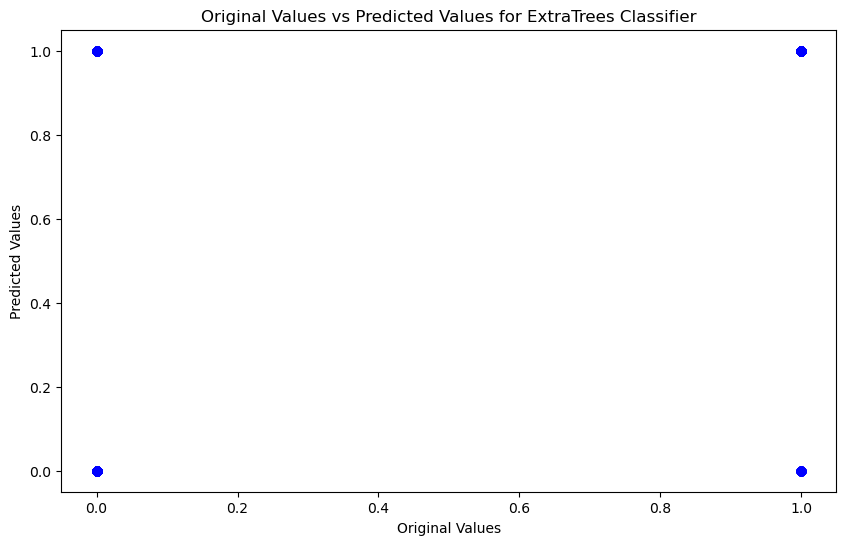

In [77]:

# Plotting the predicted values against the original values
plt.figure(figsize=(10, 6))
plt.scatter(Y_test, Y_pred_et, color='blue')
plt.xlabel('Original Values')
plt.ylabel('Predicted Values')
plt.title('Original Values vs Predicted Values for ExtraTrees Classifier')
plt.show()

In [78]:
# Data splitting for train and test data
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.3, random_state=30)

# Define the hyperparameter grid to search
param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'min_child_weight': [1, 3, 5],
    'subsample': [0.8, 0.9, 1.0],
    'colsample_bytree': [0.8, 0.9, 1.0],
    'gamma': [0, 0.1, 0.2],
    'reg_alpha': [0, 0.1, 0.2],
    'reg_lambda': [0, 0.1, 0.2]
}

# Create a RandomizedSearchCV object
random_search = RandomizedSearchCV(estimator=XGB_model, param_distributions=param_grid,
                                   n_iter=30, cv=5, scoring='accuracy', n_jobs=-1)

# Fit the RandomizedSearchCV to find the best parameters
random_search.fit(X_train, Y_train)

# Get the best hyperparameters
best_params = random_search.best_params_

# Create a classifier with the best parameters
best_xgb = XGBClassifier(**best_params)

# Fit the best classifier on the training data
best_xgb.fit(X_train, Y_train)

# Make predictions on the test data
Y_pred_xgb = best_xgb.predict(X_test)

# Evaluate the best model
accuracy = accuracy_score(Y_test, Y_pred_xgb)
print("Best Accuracy (XGBoost):", accuracy*100, "%")

Best Accuracy (XGBoost): 90.49213257448946 %


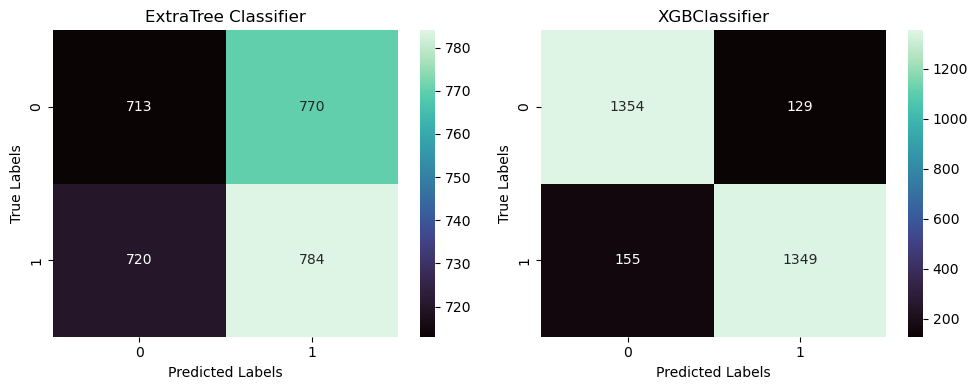

In [79]:
cm_et = confusion_matrix(Y_test, Y_pred_et)
cm_xgb = confusion_matrix(Y_test, Y_pred_xgb)

# Create subplots for the confusion matrices
fig, axes = plt.subplots(1, 2, figsize=(10, 4))

# Plot ExtraTree Classifier Confusion Matrix
sns.heatmap(cm_et, annot=True, fmt="d", cmap="mako", ax=axes[0])
axes[0].set_title('ExtraTree Classifier')
axes[0].set_xlabel('Predicted Labels')
axes[0].set_ylabel('True Labels')

# Plot XGBClassifier Confusion Matrix
sns.heatmap(cm_xgb, annot=True, fmt="d", cmap="mako", ax=axes[1])
axes[1].set_title('XGBClassifier')
axes[1].set_xlabel('Predicted Labels')
axes[1].set_ylabel('True Labels')

plt.tight_layout()
plt.show()

In [80]:
# Calculate ROC AUC Score for ExtraTree Classifier
y_prob_ET = best_et.predict_proba(X_test)[:, 1]
auc_score_ET = roc_auc_score(Y_test, y_prob_ET)
print("ROC AUC Score Of ExtraTree Classifier:", auc_score_ET)

# Calculate ROC AUC Score for XGBClassifier
y_prob_XGB = best_xgb.predict_proba(X_test)[:, 1]
auc_score_XGB = roc_auc_score(Y_test, y_prob_XGB)
print("ROC AUC Score Of XGBClassifier:", auc_score_XGB)

ROC AUC Score Of ExtraTree Classifier: 0.9975105719430137
ROC AUC Score Of XGBClassifier: 0.9668902705843532


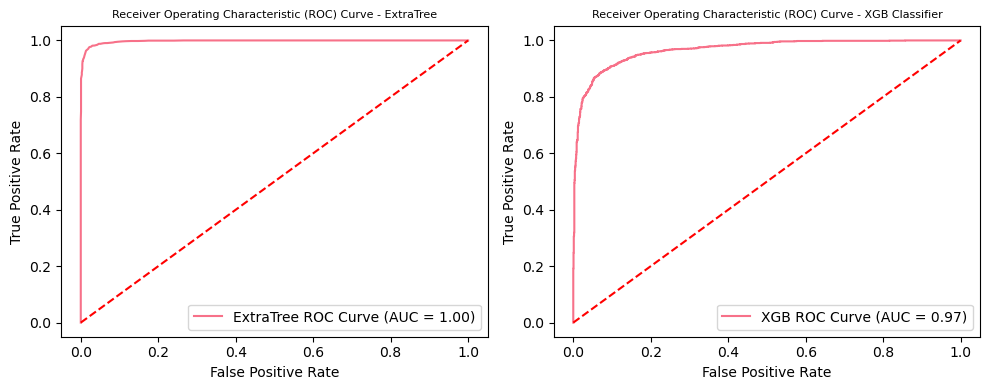

In [81]:
# Calculate ROC curves for both classifiers
fpr_ET, tpr_ET, _ = roc_curve(Y_test, y_prob_ET)
fpr_xgb, tpr_xgb, _ = roc_curve(Y_test, y_prob_XGB)

# Create subplots
plt.figure(figsize=(10, 4))

# Plot ROC curve for ExtraTree Classifier
plt.subplot(1, 2, 1)
plt.plot(fpr_ET, tpr_ET, label='ExtraTree ROC Curve (AUC = {:.2f})'.format(auc_score_ET))
plt.plot([0, 1], [0, 1], 'r--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve - ExtraTree', fontsize=8)
plt.legend(loc='lower right')

# Plot ROC curve for Support Vector Classifier
plt.subplot(1, 2, 2)
plt.plot(fpr_xgb, tpr_xgb, label='XGB ROC Curve (AUC = {:.2f})'.format(auc_score_XGB))
plt.plot([0, 1], [0, 1], 'r--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve - XGB Classifier',fontsize=8)
plt.legend(loc='lower right')

# Adjust layout and show plots
plt.tight_layout()
plt.show()

CLEARLY IT IS VERIFIED AS PREVIOUSLY THE TWO CLASSIFICATION MODELS HAD PERFOMED WELL AMONGST ALL THE POSSIBLE OTHER BUT NOW AFTER HYPERPARAMETER TUNING ITT MORE ACCURATE IN PREDICTING DATA AND NOW THE EXTRA TREES CLASSIFIER HAD A SCORE OF 92% WHICH IS HIGHER THAN THE XGBOOST CLASSIFIER SCORE OF 90%. THUS EXTRA TREES CLASSIFIER IS CHOOSEN AS THE BEST MODEL TO PERFORM ON THIS DATA FOR PREDICTING THE POSSIBILITY OF WHETHER IT WOULD RAIN TOMMOROW OR NOT.

# SELECTING THE BEST POSSIBLE REGRESSION MODEL FOR  PREDICTING THE AMOUNT OF RAINFALL

AS THIS IS A CLASSIC REGRESSION PROBLEM ON PREDICTING THE AMOUNT (VALUE) OF RAIN THUS ALL THE POSSIBLE REGRESSION MODELS ARE USED.

In [82]:
# Initialize all the models
LR_model = LinearRegression()
RD_model = Ridge()
Lasso_model = Lasso()
DT_model = DecisionTreeRegressor()
KNR_model = KNeighborsRegressor()
RFR_model = RandomForestRegressor()
SGH_model = SGDRegressor()
Bag_model = BaggingRegressor()
GB_model = GradientBoostingRegressor()
XGB_model = XGBRegressor()
ADA_model= AdaBoostRegressor()


# Create a list of models for iteration
models = [
    (LR_model, 'Linear Regression'),
    (RD_model, 'Ridge'),
    (Lasso_model, 'Lasso'),
    (DT_model, 'Decision Tree'),
    (KNR_model, 'KNeighbors'),
    (RFR_model, 'RandomForest'),
    (SGH_model, 'SGDRegressor'),
    (Bag_model, 'Bagging Regressor'),
    (GB_model, 'GradientBoostingRegressor'),
    (XGB_model, 'XGBRegressor'),
    (ADA_model, 'AdaBoostRegressor')
]


In [83]:
# Function to check for best random state and R2 score
def maxr2_score(tec, x, y):
    max_r_score = 0
    final_r_state = 0
    for r_state in range(1, 100):
        train_x, test_x, train_y, test_y = train_test_split(x, y, random_state=r_state, test_size=0.30)
        tec.fit(train_x, train_y)
        pred = tec.predict(test_x)
        temp = r2_score(test_y, pred)
        if temp > max_r_score:
            max_r_score = temp
            final_r_state = r_state
    return max_r_score, final_r_state
# Create a DataFrame to store the results
results = []



In [84]:
# Iterate through models and calculate the best random state, R2 score, MSE, and MAE
for model, model_name in models:
    max_r2, best_random_state = maxr2_score(model, X1, Y1)
    X_train, X_test, y_train, y_test = train_test_split(X1, Y1, test_size=0.2, random_state=best_random_state)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    r2 = r2_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    
    results.append({
        'Model': model_name,
        'Best R2 Score': max_r2,
        'Best Random State': best_random_state,
        'MSE': mse,
        'MAE': mae,
    })

# Create a DataFrame from the results list
results_df = pd.DataFrame(results)

# Sort the DataFrame by "Best R2 Score" in descending order
sorted_results_df = results_df.sort_values(by='Best R2 Score', ascending=False)
sorted_results_df
   


,Model,Best R2 Score,Best Random State,MSE,MAE
8,GradientBoostingRegressor,0.429400,77,0.564435,0.559418
5,RandomForest,0.412756,46,0.601319,0.571246
9,XGBRegressor,0.384454,12,0.589002,0.548223
7,Bagging Regressor,0.373519,77,0.644324,0.570529
6,SGDRegressor,0.353432,77,0.650480,0.649757
1,Ridge,0.353288,77,0.644021,0.648052
0,Linear Regression,0.353276,77,0.644038,0.648049
4,KNeighbors,0.306885,30,0.700896,0.578271
10,AdaBoostRegressor,0.295456,42,0.733564,0.756519
2,Lasso,0.000000,0,0.964668,0.853502


In [85]:
sorted_results_df.head(2)

,Model,Best R2 Score,Best Random State,MSE,MAE
8,GradientBoostingRegressor,0.429400,77,0.564435,0.559418
5,RandomForest,0.412756,46,0.601319,0.571246


# HYPERPARAMETER TUNING

In [86]:
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error

# Data Splitting for Train & Test Data
train_x, test_x, train_y, test_y = train_test_split(X1, Y1, random_state=46, test_size=0.30)

# Define the hyperparameter grid to search
param_grid = {
    'n_estimators': [100, 200, 300],  # Number of boosting stages
    'learning_rate': [0.01, 0.1, 0.2],  # Learning rate for each boosting stage
    'max_depth': [3, 4, 5, None],  # Maximum depth of individual decision trees
    'min_samples_split': [2, 5, 10],  # Minimum number of samples required to split a node
    'min_samples_leaf': [1, 2, 4]   # Minimum number of samples allowed in a leaf node
}

# Create a RandomizedSearchCV object with parallel processing
random_search = RandomizedSearchCV(estimator=GradientBoostingRegressor(), param_distributions=param_grid,
                                   n_iter=30, scoring='r2', cv=5, n_jobs=-1)

# Fit the RandomizedSearchCV to your data
random_search.fit(train_x, train_y)

# Get the best hyperparameters
best_params = random_search.best_params_

# Create a regressor with the best parameters
best_GBM = GradientBoostingRegressor(**best_params)

# Perform cross-validation to calculate the R-squared score
cv_scores = cross_val_score(best_GBM, X1, Y1, cv=5, scoring='r2')

# Fit the best regressor on the training data
best_GBM.fit(train_x, train_y)

# Make predictions on the test data
y_pred_GBM = best_GBM.predict(test_x)

# Evaluate the best model
r2_score_GBM = r2_score(test_y, y_pred_GBM)
print('Best R-squared Score (Gradient Boosting Regressor):', r2_score_GBM)

mse_GBM = mean_squared_error(test_y, y_pred_GBM)
print('Mean Squared Error (MSE) (Gradient Boosting Regressor):', mse_GBM)

mae_GBM = mean_absolute_error(test_y, y_pred_GBM)
print('Mean Absolute Error (MAE) (Gradient Boosting Regressor):', mae_GBM)

# Print cross-validated R-squared scores
print('Cross-Validated R-squared Scores (Gradient Boosting Regressor):', cv_scores.mean())


Best R-squared Score (Gradient Boosting Regressor): 0.4182138451019186
Mean Squared Error (MSE) (Gradient Boosting Regressor): 0.598721013481645
Mean Absolute Error (MAE) (Gradient Boosting Regressor): 0.5618977142484627
Cross-Validated R-squared Scores (Gradient Boosting Regressor): 0.3558613128135565


HYPERPARAMETER TUNING OF RANDOM FOREST REGRESSOR

In [89]:
# Data Splitting for Train & Test Data
train_x, test_x, train_y, test_y = train_test_split(X1, Y1, random_state=46, test_size=0.30)

# Define the hyperparameter grid to search
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 4, 5, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Create a RandomizedSearchCV object with parallel processing
random_search = RandomizedSearchCV(estimator=RFR_model, param_distributions=param_grid,
                                   n_iter=30, scoring='r2', cv=5, n_jobs=-1)

# Fit the RandomizedSearchCV to your data
random_search.fit(train_x, train_y)

# Get the best hyperparameters
best_params = random_search.best_params_

# Create a regressor with the best parameters
best_RFRegressor = RandomForestRegressor(**best_params)

# Perform cross-validation to calculate the R-squared score
cv_scores = cross_val_score(best_RFRegressor, X1, Y1, cv=5, scoring='r2')

# Fit the best regressor on the training data
best_RFRegressor.fit(train_x, train_y)

# Make predictions on the test data
y_pred_RFRegressor = best_RFRegressor.predict(test_x)

# Evaluate the best model
r2_score_RFRegressor = r2_score(test_y, y_pred_RFRegressor)
print('Best R-squared Score (Random Forest Regressor):', r2_score_RFRegressor)

mse_RFRegressor = mean_squared_error(test_y, y_pred_RFRegressor)
print('Mean Squared Error (MSE) (Random Forest Regressor):', mse_RFRegressor)

mae_RFRegressor = mean_absolute_error(test_y, y_pred_RFRegressor)
print('Mean Absolute Error (MAE) (Random Forest Regressor):', mae_RFRegressor)

# Print cross-validated R-squared scores
print('Cross-Validated R-squared Scores (Random Forest Regressor):', cv_scores.mean())

Best R-squared Score (Random Forest Regressor): 0.4288064955692943
Mean Squared Error (MSE) (Random Forest Regressor): 0.5878200280080477
Mean Absolute Error (MAE) (Random Forest Regressor): 0.558917034002782
Cross-Validated R-squared Scores (Random Forest Regressor): 0.3393160354344106


# SAVING THE BEST MODEL

In [90]:
import pickle

# Assuming you have already fit the model 'best_GBM'

# Open a file in binary write mode ('wb') for writing the pickled model
with open('gradient_boosting_model.pkl', 'wb') as file:
    pickle.dump(best_GBM, file)

print("Gradient Boosting model saved successfully!")


Gradient Boosting model saved successfully!
